In [ ]:
from google.colab import drive
import os
import zipfile
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split, Dataset,sampler
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np
from torch.optim.lr_scheduler import ReduceLROnPlateau

drive.mount('/content/drive')

zip_path = '/content/drive/MyDrive/DeepLearningProje/realwaste.zip'

extract_path = '/content/dataset_root'

if not os.path.exists(extract_path):
    os.makedirs(extract_path)

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print("Veri çıkarma işlemi tamamlandı", extract_path)
else:
    print("Klasör zaten var, tekrar çıkarmaya gerek yok.")


global_loss_accuracy={}

print(os.listdir(extract_path))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Klasör zaten var, tekrar çıkarmaya gerek yok.
['realwaste-main']


In [ ]:
# Colab gpu kontrolü
USE_GPU = True

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

print(f"\nEğitim {device} üzerinde yapılacak.")


Eğitim cuda üzerinde yapılacak.


# **Ortam Hazırlıkları**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class FocalLoss(nn.Module):
    def __init__(self, alpha=0.25, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, predictions, ground_truth):

        ce_loss = F.cross_entropy(predictions, ground_truth, reduction='none')

        pt = torch.exp(-ce_loss)

        focal_loss = self.alpha * (1 - pt)**self.gamma * ce_loss

        if self.reduction == 'mean':
            return focal_loss.mean()
        elif self.reduction == 'sum':
            return focal_loss.sum()
        else:
            return focal_loss

In [ ]:
def mixup_cutmix(batch, min_cut_ratio=0.15, max_cut_ratio=0.60):

    images, labels = zip(*batch)
    images = torch.stack(images, 0)
    labels = torch.tensor(labels)

    augmentation_prob = np.random.rand()

    if augmentation_prob >= 0.4:
        return images, labels

    batch_size = images.size(0)
    shuffled_indices = torch.randperm(batch_size)

    label_a = labels
    label_b = labels[shuffled_indices]

    if augmentation_prob < 0.2:
        mix_ratio = np.random.beta(1.0, 1.0)
        images = mix_ratio * images + (1 - mix_ratio) * images[shuffled_indices]
        mix_ratio_final = mix_ratio

    else:
        image_height = images.size(2)
        image_width = images.size(3)

        cut_size_ratio = np.random.uniform(min_cut_ratio, max_cut_ratio)
        cut_height = int(image_height * cut_size_ratio)
        cut_width = int(image_width * cut_size_ratio)

        center_x = image_width // 2
        center_y = image_height // 2

        source_y1 = center_y - cut_height // 2
        source_x1 = center_x - cut_width // 2
        source_y2 = source_y1 + cut_height
        source_x2 = source_x1 + cut_width

        # 2. Kenar bölgesi seçimi
        edge_type = np.random.choice(['top', 'bottom', 'left', 'right'])

        max_y = image_height - cut_height
        max_x = image_width - cut_width

        edge_zone = int(min(image_height, image_width) * 0.20)

        if edge_type == 'top':
            target_y = np.random.randint(0, min(edge_zone, max_y) + 1)
            target_x = np.random.randint(0, max_x + 1)
        elif edge_type == 'bottom':
            target_y = np.random.randint(max(max_y - edge_zone, 0), max_y + 1)
            target_x = np.random.randint(0, max_x + 1)
        elif edge_type == 'left':
            target_x = np.random.randint(0, min(edge_zone, max_x) + 1)
            target_y = np.random.randint(0, max_y + 1)
        else:  # right
            target_x = np.random.randint(max(max_x - edge_zone, 0), max_x + 1)
            target_y = np.random.randint(0, max_y + 1)

        target_y2 = target_y + cut_height
        target_x2 = target_x + cut_width

       # kesip yapıştırma
        cut_region = images[shuffled_indices, :, source_y1:source_y2, source_x1:source_x2]
        images[:, :, target_y:target_y2, target_x:target_x2] = cut_region

        # Mix ratio
        cut_area = cut_height * cut_width
        total_area = image_height * image_width
        mix_ratio_final = 1.0 - (cut_area / total_area)

    return images, (label_a, label_b, mix_ratio_final)

In [ ]:
from collections import Counter
import copy
from torch.utils.data import Subset

def get_data_loaders(
    IMG_SIZE=224,
    BATCH_SIZE=32,
    DATA_PATH ='/content/dataset_root/realwaste-main/RealWaste',
    imgNET_stats = ((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
    ):


  from torchvision.transforms import TrivialAugmentWide
  """
  train_transform = T.Compose([
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.RandomRotation(degrees=45),
    T.RandomHorizontalFlip(p=0.5),
    T.RandomVerticalFlip(p=0.5),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.2, hue=0.08),
    T.RandomPerspective(distortion_scale=0.15, p=0.3),
    T.RandomResizedCrop(IMG_SIZE, scale=(0.85, 1.0), ratio=(0.9, 1.1)),
    T.ToTensor(),
    T.Normalize(*imgNET_stats)
  ])

  """
  train_transform = T.Compose([
      T.Resize((IMG_SIZE, IMG_SIZE)),
      TrivialAugmentWide(),
      T.ToTensor(),
      T.Normalize(*imgNET_stats)
  ])
  """
  #Transforms
  train_transform = T.Compose([
      T.Resize((IMG_SIZE, IMG_SIZE)),
      T.RandomRotation(degrees=30),     # resim açısı
      T.RandomHorizontalFlip(p=0.5),    # aynalama
      T.RandomVerticalFlip(p=0.5),      # ters dönme
      T.ColorJitter(brightness=0.2, contrast=0.2), # ışık kontrast ayarı
      T.ToTensor(),
      T.Normalize(*imgNET_stats)
  ])
"""
  """
  train_transform = T.Compose([
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.RandomRotation(degrees=45),
    T.RandomHorizontalFlip(p=0.5),
    T.RandomVerticalFlip(p=0.5),
    T.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.1),
    T.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    T.RandomPerspective(distortion_scale=0.2, p=0.5),
    T.ToTensor(),
    T.Normalize(*imgNET_stats),
    T.RandomErasing(p=0.3, scale=(0.02, 0.15))
  ])
  """
  val_test_transform = T.Compose([
      T.Resize((IMG_SIZE, IMG_SIZE)),
      T.ToTensor(),
      T.Normalize(*imgNET_stats)
  ])

  full_dataset = ImageFolder(root=DATA_PATH, transform=None)

  total_count = len(full_dataset)
  train_count = int(0.8 * total_count)
  val_count = int(0.1 * total_count)
  test_count = total_count - train_count - val_count

  train_subset_idx, val_subset_idx, test_subset_idx = random_split(
      full_dataset, [train_count, val_count, test_count],
      generator=torch.Generator().manual_seed(42)
  )

  val_labels = [val_subset_idx.dataset.targets[i] for i in val_subset_idx.indices]
  print("Val Set Sınıf Dağılımı:", Counter(val_labels))

  train_dataset_copy=copy.deepcopy(full_dataset)
  train_dataset_copy.transform=train_transform

  val_test_dataset_copy=copy.deepcopy(full_dataset)
  val_test_dataset_copy.transform=val_test_transform

  train_data = Subset(train_dataset_copy, train_subset_idx.indices)
  val_data = Subset(val_test_dataset_copy, val_subset_idx.indices)
  test_data = Subset(val_test_dataset_copy, test_subset_idx.indices)


  print(f"Total: {total_count}")
  print(f"Train : {len(train_data)}  Val: {len(val_data)}  Test: {len(test_data)}")

  #DATALOADERS
  loader_train = DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True,num_workers=2, pin_memory=True,collate_fn=mixup_cutmix)
  loader_val = DataLoader(val_data, batch_size=BATCH_SIZE, shuffle=False,num_workers=2, pin_memory=True)
  loader_test = DataLoader(test_data, batch_size=BATCH_SIZE, shuffle=False,num_workers=2, pin_memory=True)

  return full_dataset, loader_train, loader_val, loader_test



In [ ]:
# Model trainer

def train_model(model,
                train_loader,
                val_loader,
                loss_function,
                optimizer,
                model_name,
                num_epochs=10,
                loss_border=None,
                verbose=True,
                scheduler=None):

    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []
    best_acc=0

    for epoch in range(num_epochs):
        model.train()
        total_loss=0
        correct=0
        total = 0

        for images, labels in train_loader:
            images = images.to(device)

            if isinstance(labels, (tuple, list)) and len(labels) == 3:
                target_a, target_b, lam = labels
                target_a= target_a.to(device)
                target_b= target_b.to(device)

                outputs = model(images)
                loss = lam * loss_function(outputs, target_a) + (1 - lam) * loss_function(outputs, target_b)

                _, predicted = torch.max(outputs, 1)
                correct += (predicted == target_a).sum().item()
            else:
                if isinstance(labels, (list, tuple)):
                    labels = torch.tensor(labels)

                labels = labels.to(device)
                outputs = model(images)
                loss = loss_function(outputs, labels)

                _, predicted = torch.max(outputs, 1)
                correct += (predicted == labels).sum().item()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()


            if scheduler is not None and isinstance(scheduler, torch.optim.lr_scheduler.OneCycleLR):
                scheduler.step()

            total_loss += loss.item()
            total += images.size(0)

        epoch_loss = total_loss / len(train_loader)
        epoch_acc = correct / total * 100
        train_losses.append(epoch_loss)
        train_accs.append(epoch_acc)

        model.eval()
        val_total_loss, val_correct, val_total = 0, 0, 0
        with torch.no_grad():
            for images, labels in val_loader:
                images = images.to(device)
                if isinstance(labels, (list, tuple)):
                   labels = torch.tensor(labels)
                labels = labels.to(device)

                outputs = model(images)
                loss = loss_function(outputs, labels)
                val_total_loss += loss.item()
                val_total += labels.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()

        val_epoch_loss = val_total_loss / len(val_loader)
        val_epoch_acc = val_correct / val_total * 100
        val_losses.append(val_epoch_loss)
        val_accs.append(val_epoch_acc)

        if scheduler is not None and not isinstance(scheduler, torch.optim.lr_scheduler.OneCycleLR):
            if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                scheduler.step(val_epoch_loss)
            else:
                scheduler.step()


        if val_epoch_acc > best_acc:
          best_acc = val_epoch_acc
          best_model_wts = copy.deepcopy(model.state_dict())

        if verbose==True:
          print("\n------------------------------------------------------")
          print("Epoch:", epoch + 1)
          print("Train Loss:", epoch_loss, "Train Acc:", epoch_acc)
          print("Val Loss:", val_epoch_loss, "Val Acc:", val_epoch_acc)
          print("------------------------------------------------------\n")

        if loss_border is not None:
          if val_epoch_loss < loss_border:
            print(f"Minimum loss'a erişildi! Epoch: {epoch + 1} Value:{val_epoch_loss}")
            break

    model.load_state_dict(best_model_wts)
    torch.save(model.state_dict(), f'{model_name}.pth')
    print(f"Best Accuracy: {best_acc}")

    results=[train_losses, val_losses, train_accs, val_accs]
    return results



In [ ]:
def show_batch(dl):
    for images, labels in dl:
        plt.figure(figsize=(12, 6))
        # Normalize edilmiş veriyi geri aç
        grid_img = torchvision.utils.make_grid(images[:8], nrow=4)
        grid_img = grid_img.numpy().transpose((1, 2, 0))

        #İmage net ortalamaları geri döndür
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        grid_img = std * grid_img + mean

        #clip kullanılmalı matplotlib 0-1 arası istiyor
        grid_img = np.clip(grid_img, 0, 1)

        plt.imshow(grid_img)
        plt.axis('off')
        plt.title("Eğitim Verisi (Augmentation Uygulanmış)")
        plt.show()
        break

In [ ]:
def visualize_train_val_acc(train_loss,val_loss,train_acc,val_acc):
  plt.figure(figsize=(12, 4))

  plt.subplot(1, 2, 1)
  plt.plot(train_loss, label='Train Loss')
  plt.plot(val_loss, label='Val Loss')
  plt.title('Loss Grafiği')
  plt.legend()

  plt.subplot(1, 2, 2)
  plt.plot(train_acc, label='Train Acc')
  plt.plot(val_acc, label='Val Acc')
  plt.title('Accuracy Grafiği')
  plt.legend()
  plt.show()

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

##Test

def test_model(model, data_loader, device, class_names):
    model.eval()

    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch_inputs, batch_labels in data_loader:
            batch_inputs = batch_inputs.to(device)
            batch_labels = batch_labels.to(device)

            outputs = model(batch_inputs)
            _, preds = torch.max(outputs, 1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(batch_labels.cpu().numpy())

    print("------------------")
    print("F1 Skoru ")
    print("------------------")

    print(classification_report(all_labels, all_preds, target_names=class_names))

    cm = confusion_matrix(all_labels, all_preds)

    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, xticklabels=class_names, yticklabels=class_names)
    plt.ylabel('True')
    plt.xlabel('Prediction')
    plt.title('Confusion Matrix')
    plt.show()



# **Modeller ve Eğitimler**

Val Set Sınıf Dağılımı: Counter({6: 97, 3: 77, 5: 54, 4: 49, 8: 47, 2: 46, 1: 38, 0: 38, 7: 29})
Total: 4752
Train : 3801  Val: 475  Test: 476


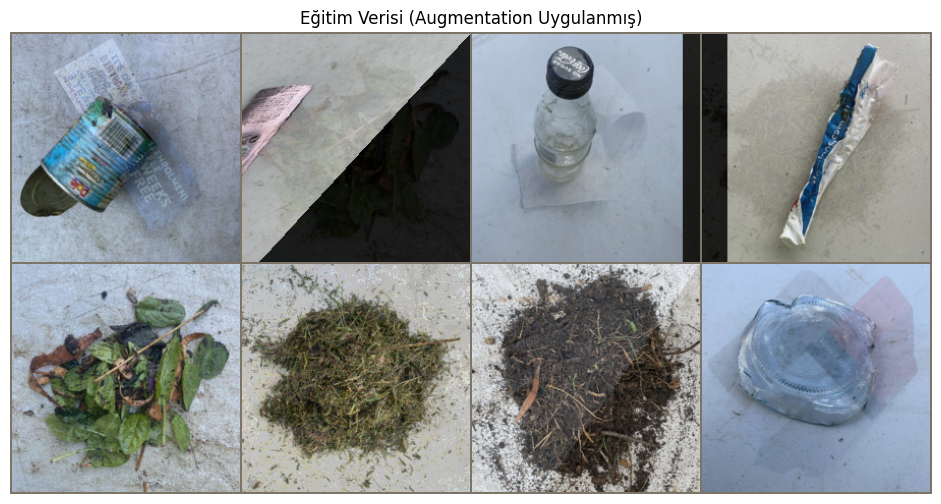

In [ ]:
from torchvision import models

IMG_SIZE=224
BATCH_SIZE=32
DATA_PATH ='/content/dataset_root/realwaste-main/RealWaste'
imgNET_stats = ((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))

full_dataset, loader_train, loader_val, loader_test=get_data_loaders(IMG_SIZE,BATCH_SIZE,DATA_PATH,imgNET_stats)
show_batch(loader_train)


if BATCH_SIZE==32:
  LEARNING_RATE_HEAD = 0.001
  LEARNING_RATE = 0.0001
elif BATCH_SIZE==64:
  LEARNING_RATE_HEAD = 0.002
  LEARNING_RATE = 0.0002
elif BATCH_SIZE==128:
  LEARNING_RATE_HEAD = 0.004
  LEARNING_RATE = 0.0004

NUM_CLASSES=len(full_dataset.classes)
global_loss_accuracy={}
EPOCHS = 25
W_DECAY=1e-4

EPOCHS_HEAD=10



In [ ]:
def auto_train_model(model,
                     model_name,
                     loader_train,
                     loader_val,
                     loss_func="cross",
                     epochs=EPOCHS,
                     learning_rate=LEARNING_RATE,
                     w_decay=W_DECAY,
                     lr_scheduler="plato"):

  if loss_func == "cross":
    loss_function = nn.CrossEntropyLoss(label_smoothing=0.1)
  else:
    loss_function = FocalLoss(gamma=2.0)

  optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=w_decay) # Weight decay arttırıldı, val_acc arttı,

  if lr_scheduler == "plato":
    scheduler = ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.3,
        patience=3,
        min_lr=1e-6,
        verbose=True
    )
  elif lr_scheduler == "one":
    scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=LEARNING_RATE * 10,
    steps_per_epoch=len(loader_train),
    epochs=epochs
    )


  results = train_model(
      model,
      loader_train,
      loader_val,
      loss_function,
      optimizer,
      model_name,
      num_epochs=epochs,
      scheduler=scheduler
  )

  visualize_train_val_acc(
      results[0],
      results[1],
      results[2],
      results[3]
  )

  global_loss_accuracy[model_name] = {
    "model":model,
    "train_loss": results[0],
    "val_loss": results[1],
    "train_acc": results[2],
    "val_acc": results[3]
  }

  return results

## ***1-Custom VGG***

In [ ]:
# Custom VGG, veri manuel hazırlanmış bir basit bir mimaride nasıl çalışıyor ?

class VGGCustom(nn.Module):
    def __init__(self, num_classes):
        super(VGGCustom, self).__init__()

        self.features = nn.Sequential(


            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2), #224 to 112

            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2), #112 to 56

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),#56 to 28

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),#28 to 14
        )

        self.average_pool = nn.AdaptiveAvgPool2d((4, 4))

        self.fully_connected_classfier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(256 * 4 * 4, 1024),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(1024, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.average_pool(x)
        x = self.fully_connected_classfier(x)
        return x


Model Oluşturuldu.  Sınıf Sayısı: 9


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(



------------------------------------------------------
Epoch: 1
Train Loss: 2.238193184387784 Train Acc: 24.835569586950804
Val Loss: 1.933839535713196 Val Acc: 30.105263157894736
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.9254474149030798 Train Acc: 29.807945277558538
Val Loss: 1.5442835013071696 Val Acc: 50.526315789473685
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.853424178452051 Train Acc: 36.5167061299658
Val Loss: 1.6664848725001018 Val Acc: 42.31578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.8471929345812117 Train Acc: 35.88529334385688
Val Loss: 1.4853587786356608 Val Acc: 56.00000000000001
------------------------------------------------------


---------------------------------------------------

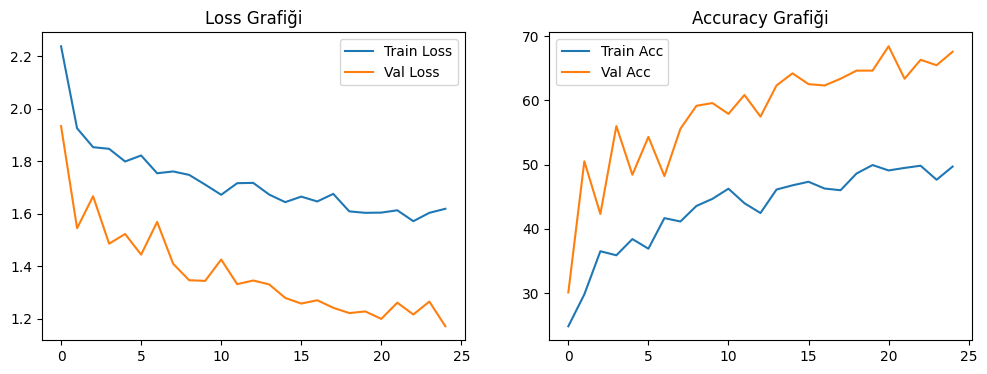

In [ ]:

customVGG = VGGCustom(num_classes=NUM_CLASSES).to(device)
model_name="customVGG"

print(f"Model Oluşturuldu.  Sınıf Sayısı: {NUM_CLASSES}")

optimizer = optim.Adam(customVGG.parameters(), lr=LEARNING_RATE, weight_decay=W_DECAY)

results=auto_train_model(
    customVGG,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,

)


## ***2-MobileNetV2 FineTuning***

In [ ]:

#Mobilenet v2 ile finetuning

def mobilenet_v2_fc(num_classes):
  model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.DEFAULT)

  for parameters in model.features.parameters():
      parameters.requires_grad = False

  output_mobilenet=model.classifier[1].in_features
  print("size ",output_mobilenet)

  model.classifier=nn.Sequential(
      nn.Linear(output_mobilenet,512),
      nn.ReLU(),
      nn.Dropout(0.5),
      nn.Linear(512,256),
      nn.ReLU(),
      nn.Dropout(0.5),
      nn.Linear(256,num_classes),
      nn.LogSoftmax(dim=1)
  )
  return model

def mobilenet_v2_finetune(model,unfreeze=3):

  unfreeze_size=len(model.features)-unfreeze

  for parameters in model.features[unfreeze_size:].parameters():
      parameters.requires_grad = True

  for parameters in model.features[:unfreeze_size].parameters():
      parameters.requires_grad = False

  for param in model.classifier.parameters():
        param.requires_grad = True

  return model



size  1280
Model Oluşturuldu.  Sınıf Sayısı: 9

------------------------------------------------------
Epoch: 1
Train Loss: 1.7477911089648719 Train Acc: 40.620889239673765
Val Loss: 1.2355611205101014 Val Acc: 64.84210526315789
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.4370790429475928 Train Acc: 57.69534333070244
Val Loss: 1.088492202758789 Val Acc: 72.0
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.3526313019399883 Train Acc: 60.27361220731387
Val Loss: 1.0458751559257506 Val Acc: 74.31578947368422
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.3639210262218444 Train Acc: 61.61536437779531
Val Loss: 1.0176150401433308 Val Acc: 77.89473684210526
------------------------------------------------------


-----------------

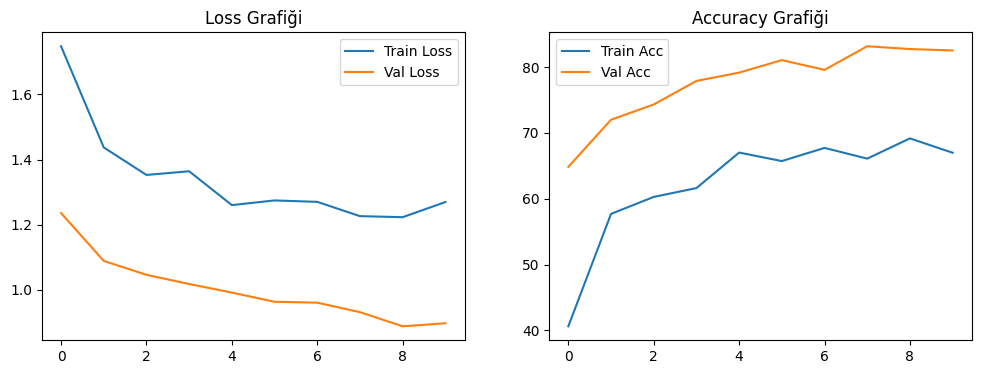

19
4
Sequential(
  (9): InvertedResidual(
    (conv): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (1): Conv2dNormActivation(
        (0): Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=384, bias=False)
        (1): BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU6(inplace=True)
      )
      (2): Conv2d(384, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (10): InvertedResidual(
    (conv): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(64, 384, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_s

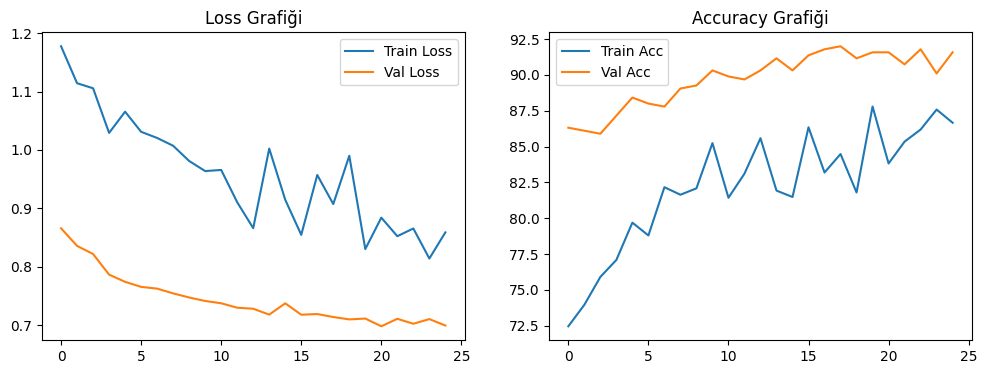

In [ ]:
mobileNet2_fc=mobilenet_v2_fc(NUM_CLASSES).to(device)
model_name="mobileNet2_fc"

print(f"Model Oluşturuldu.  Sınıf Sayısı: {NUM_CLASSES}")

optimizer = optim.Adam(mobileNet2_fc.parameters(), lr=LEARNING_RATE_HEAD, weight_decay=W_DECAY)



results=auto_train_model(
    mobileNet2_fc,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


layers_size=len(mobileNet2_fc.features)
print(len(mobileNet2_fc.features))
print(len(mobileNet2_fc.features[15:]))
print(mobileNet2_fc.features[-10:])


mobileNet2_copy_unfreeze=copy.deepcopy(mobileNet2_fc)
mobileNet2_finetuned=mobilenet_v2_finetune(mobileNet2_copy_unfreeze,unfreeze=4).to(device)
model_name="mobileNet2_finetuned"
print(f"Model Oluşturuldu.  Sınıf Sayısı: {NUM_CLASSES}")

optimizer = optim.Adam(mobileNet2_finetuned.parameters(), lr=LEARNING_RATE, weight_decay=W_DECAY)

results=auto_train_model(
    mobileNet2_finetuned,
    model_name,
    loader_train,
    loader_val
)



# ***ResNet & EfficientNet & CBAM/SimAM***

### ***Hazırlıklar***

In [ ]:
from torchvision.models.resnet import BasicBlock, Bottleneck
import types
import torch.nn.functional as F
import math

#attention fonksiyonları
class CBAM_module(nn.Module):
  def __init__(self,channels):
    super(CBAM_module,self).__init__()

    #Channel Attention
    self.pool_max=nn.AdaptiveMaxPool2d(1) #channelx1x1
    self.pool_avg=nn.AdaptiveAvgPool2d(1) #channelx1x1

    channel_mlp= max(channels//16, 1)

    self.mlp=nn.Sequential(
        nn.Conv2d(channels, channel_mlp, kernel_size=1),
        nn.ReLU(),
        nn.Conv2d(channel_mlp, channels, kernel_size=1)
    )

    #Spatial Attention
    self.conv_spatial=nn.Conv2d(2,1,kernel_size=7,padding=3) # max channel + avg channel toplam 2 layer

    self.sigmoid=nn.Sigmoid()

    with torch.no_grad():
            self.mlp[2].weight.zero_()
            self.mlp[2].bias.zero_()
            self.conv_spatial.weight.zero_()
            self.conv_spatial.bias.zero_()

  def forward(self,x):
    #Channel
    mlp_max=self.mlp(self.pool_max(x))
    mlp_avg=self.mlp(self.pool_avg(x))

    mlp_out=mlp_max+mlp_avg

    output_channel=self.sigmoid(mlp_out)

    x_chnl=x*output_channel

    ##Spatial
    max_channel,_=torch.max(x_chnl,dim=1,keepdim=True)
    avg_channel=torch.mean(x_chnl,dim=1,keepdim=True)
    combined_channels=torch.cat([max_channel,avg_channel],dim=1)

    output_spatial=self.sigmoid(self.conv_spatial(combined_channels))

    x_final=x_chnl*output_spatial

    return x_final

class SimAM_module(nn.Module):
    def __init__(self, e_lambda=1e-4):
        super(SimAM_module, self).__init__()
        self.activaton = nn.Sigmoid()
        self.e_lambda = e_lambda

    def forward(self, x):
        b, c, h, w = x.size()
        n = w * h - 1

        # Ortalama ve varyans hesaplama (enerji fonksiyonu için)
        x_minus_mu_square = (x - x.mean(dim=[2, 3], keepdim=True)).pow(2)
        y = x_minus_mu_square / (4 * (x_minus_mu_square.sum(dim=[2, 3], keepdim=True) / n + self.e_lambda)) + 0.5

        return x * self.activaton(y)

class CoordinateAttention(nn.Module):
    def __init__(self, in_channels, reduction_ratio=32):
        super(CoordinateAttention, self).__init__()

        bottleneck_channels = max(8, in_channels // reduction_ratio)

        self.pool_height = nn.AdaptiveAvgPool2d((None, 1))
        self.pool_width = nn.AdaptiveAvgPool2d((1, None))

        self.shared_conv = nn.Conv2d(in_channels, bottleneck_channels, kernel_size=1, stride=1, padding=0)
        self.shared_bn = nn.BatchNorm2d(bottleneck_channels)
        self.activation = nn.ReLU(inplace=True)

        self.conv_height = nn.Conv2d(bottleneck_channels, in_channels, kernel_size=1, stride=1, padding=0)
        self.conv_width = nn.Conv2d(bottleneck_channels, in_channels, kernel_size=1, stride=1, padding=0)

        self._init_weights()

    def _init_weights(self):
        nn.init.constant_(self.conv_height.weight, 0)
        nn.init.constant_(self.conv_height.bias, 0)
        nn.init.constant_(self.conv_width.weight, 0)
        nn.init.constant_(self.conv_width.bias, 0)

    def forward(self, x):
        identity = x
        batch, channel, height, width = x.size()

        feat_h = self.pool_height(x)
        feat_w = self.pool_width(x).permute(0, 1, 3, 2)

        combined_feat = torch.cat([feat_h, feat_w], dim=2)

        combined_feat = self.shared_conv(combined_feat)
        combined_feat = self.shared_bn(combined_feat)
        combined_feat = self.activation(combined_feat)

        attn_h, attn_w = torch.split(combined_feat, [height, width], dim=2)
        attn_w = attn_w.permute(0, 1, 3, 2)

        mask_h = self.conv_height(attn_h).sigmoid()
        mask_w = self.conv_width(attn_w).sigmoid()

        return identity * mask_h * mask_w

class SE_module(nn.Module):
    def __init__(self, channels, reduction=16):
        super(SE_module, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Conv2d(channels, channels // reduction, kernel_size=1)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channels // reduction, channels, kernel_size=1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        module_input = x
        x = self.avg_pool(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        return module_input * x


#efficient attention ekleme (SE ile yer değiştirmeli)
def replace_se_cbam(model):
  for name,module in model.named_modules():
    if isinstance(module,models.efficientnet.SqueezeExcitation):
      print(f"Position= {name}, Input Channel= {module.fc1.in_channels}")
      index=name.split(".")[-1]
      print(f"Index= {index}")
      position=".".join(name.split(".")[:-1])
      print(f"Parent= {position}")

      parent_modal=model

      for i in position.split("."):
        parent_modal=getattr(parent_modal,i)

      setattr(parent_modal,index,CBAM_module(module.fc1.in_channels).to(device))

  print(model.features)
  return model


def replace_se_simam(model):
    for name, module in model.named_modules():
        if isinstance(module, models.efficientnet.SqueezeExcitation):
            index = name.split(".")[-1]
            position = ".".join(name.split(".")[:-1])

            parent_module = model
            for i in position.split("."):
                parent_module = getattr(parent_module, i)

            setattr(parent_module, index, SimAM_module().to(device))
    return model

def replace_se_ca(model):
    for name, module in model.named_modules():
        if isinstance(module, models.efficientnet.SqueezeExcitation):
            index = name.split(".")[-1]
            position = ".".join(name.split(".")[:-1])

            parent_module = model
            for i in position.split("."):
                parent_module = getattr(parent_module, i)

            setattr(parent_module, index, CoordinateAttention(module.fc1.in_channels).to(device))
    return model

#resnet attention ekleme

def prepare_resnet_block(module):
    if not hasattr(module, 'attention_list'):
        module.attention_list = []

def resnet_se(model):
    for name, module in model.named_modules():
        if isinstance(module, (BasicBlock, Bottleneck)):
            prepare_resnet_block(module)

            if isinstance(module, BasicBlock):
                channels = module.conv2.out_channels
            else:
                channels = module.conv3.out_channels

            setattr(module, 'se', SE_module(channels).to(device))

            if 'se' not in module.attention_list:
                module.attention_list.append('se')

            def new_forward(self, x):
                identity = x
                out = self.conv1(x)
                out = self.bn1(out)
                out = self.relu(out)
                out = self.conv2(out)
                out = self.bn2(out)
                if hasattr(self, 'conv3'):
                    out = self.relu(out)
                    out = self.conv3(out)
                    out = self.bn3(out)

                for att_name in self.attention_list:
                    attention_module = getattr(self, att_name)
                    out = attention_module(out)

                if self.downsample is not None:
                    identity = self.downsample(x)
                out += identity
                out = self.relu(out)
                return out

            module.forward = types.MethodType(new_forward, module)
    return model

def resNet_ca(model):
    for name, module in model.named_modules():
        if isinstance(module, (BasicBlock, Bottleneck)):
            prepare_resnet_block(module)

            if isinstance(module, BasicBlock):
                channels = module.conv2.out_channels
            else:
                channels = module.conv3.out_channels

            setattr(module, 'ca', CoordinateAttention(channels).to(device))

            if 'ca' not in module.attention_list:
                module.attention_list.append('ca')

            def new_forward(self, x):
                identity = x
                out = self.conv1(x)
                out = self.bn1(out)
                out = self.relu(out)
                out = self.conv2(out)
                out = self.bn2(out)
                if hasattr(self, 'conv3'):
                    out = self.relu(out)
                    out = self.conv3(out)
                    out = self.bn3(out)

                for att_name in self.attention_list:
                    attention_module = getattr(self, att_name)
                    out = attention_module(out)

                if self.downsample is not None:
                    identity = self.downsample(x)
                out += identity
                out = self.relu(out)
                return out

            module.forward = types.MethodType(new_forward, module)
    return model

def resnet_cbam(model):
    for name, module in model.named_modules():
        if isinstance(module, (BasicBlock, Bottleneck)):
            prepare_resnet_block(module)

            if isinstance(module, BasicBlock):
                channels = module.conv2.out_channels
            else:
                channels = module.conv3.out_channels

            setattr(module, 'cbam', CBAM_module(channels).to(device))

            if 'cbam' not in module.attention_list:
                module.attention_list.append('cbam')

            def new_forward(self, x):
                identity = x
                out = self.conv1(x)
                out = self.bn1(out)
                out = self.relu(out)
                out = self.conv2(out)
                out = self.bn2(out)
                if hasattr(self, 'conv3'):
                    out = self.relu(out)
                    out = self.conv3(out)
                    out = self.bn3(out)

                for att_name in self.attention_list:
                    attention_module = getattr(self, att_name)
                    out = attention_module(out)

                if self.downsample is not None:
                    identity = self.downsample(x)
                out += identity
                out = self.relu(out)
                return out

            module.forward = types.MethodType(new_forward, module)
    return model

def resnet_simam(model):
    for name, module in model.named_modules():
        if isinstance(module, (BasicBlock, Bottleneck)):
            prepare_resnet_block(module)

            if isinstance(module, BasicBlock):
                channels = module.conv2.out_channels
            else:
                channels = module.conv3.out_channels

            setattr(module, 'simam', SimAM_module().to(device))

            if 'simam' not in module.attention_list:
                module.attention_list.append('simam')

            def new_forward(self, x):
                identity = x
                out = self.conv1(x)
                out = self.bn1(out)
                out = self.relu(out)
                out = self.conv2(out)
                out = self.bn2(out)
                if hasattr(self, 'conv3'):
                    out = self.relu(out)
                    out = self.conv3(out)
                    out = self.bn3(out)

                for att_name in self.attention_list:
                    attention_module = getattr(self, att_name)
                    out = attention_module(out)

                if self.downsample is not None:
                    identity = self.downsample(x)
                out += identity
                out = self.relu(out)
                return out

            module.forward = types.MethodType(new_forward, module)
    return model


#### SE -> CA veya CBAM
def se_ca(model):
    modules_list = (models.efficientnet.SqueezeExcitation, SE_module)

    for name, module in model.named_modules():
        if isinstance(module, modules_list):
            channels = module.fc1.in_channels

            index = name.split(".")[-1]
            position = ".".join(name.split(".")[:-1])

            parent_module = model
            for part in position.split("."):
                parent_module = getattr(parent_module, part)

            se_ca_combo = nn.Sequential(
                module,
                CoordinateAttention(channels).to(device)
            )

            setattr(parent_module, index, se_ca_combo)
    return model

def se_cbam(model):
    modules_list = (models.efficientnet.SqueezeExcitation, SE_module)

    for name, module in model.named_modules():
        if isinstance(module, modules_list):
            channels = module.fc1.in_channels

            index = name.split(".")[-1]
            position = ".".join(name.split(".")[:-1])

            parent_module = model
            for part in position.split("."):
                parent_module = getattr(parent_module, part)

            se_cbam_combo = nn.Sequential(
                module,
                CBAM_module(channels).to(device)
            )

            setattr(parent_module, index, se_cbam_combo)
    return model


In [ ]:
def resnet_fc(num_classes, model_name='resnet18', cbam=False, simam=False,SE_toCBAM=False,SE_toCA=False,ca=False):

    if model_name == 'resnet18':
        model = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
    elif model_name == 'resnet50':
        model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)

    if cbam:
        model = resnet_cbam(model)
    if simam:
        model = resnet_simam(model)
    if SE_toCBAM:
        model= resnet_se(model)
        model = se_cbam(model)
    if SE_toCA:
        model= resnet_se(model)
        model = se_ca(model)
    if ca:
        model = resNet_ca(model)

    for parameters in model.parameters():
        parameters.requires_grad = False

    # Attention parametrelerini unfreeze et
    if cbam:
      for name, param in model.named_parameters():
          if "mlp" in name or "conv_spatial" in name:
              param.requires_grad = True

    if SE_toCA:
      modules_list = (CoordinateAttention, SE_module)
      for module in model.modules():
          if isinstance(module, modules_list):
              for param in module.parameters():
                  param.requires_grad = True

    if SE_toCBAM:
      modules_list = (CBAM_module, SE_module)
      for module in model.modules():
          if isinstance(module, modules_list):
              for param in module.parameters():
                  param.requires_grad = True

    if ca:
      for module in model.modules():
          if isinstance(module, CoordinateAttention):
              for param in module.parameters():
                  param.requires_grad = True

    output_features = model.fc.in_features
    print("size ", output_features)

    model.fc = nn.Sequential(
          nn.Linear(output_features, 512),
          nn.BatchNorm1d(512),
          nn.ReLU(),
          nn.Dropout(0.5),

          nn.Linear(512, 256),
          nn.BatchNorm1d(256),
          nn.ReLU(),
          nn.Dropout(0.3),

          nn.Linear(256, num_classes)
      )
    return model

def resnet_finetune(model, unfreeze=1, cbam=False,SE_toCA=False,SE_toCBAM=False,ca=False):

    for param in model.parameters():
        param.requires_grad = False

    # attention parametrelerini unfreeze et
    if cbam:
        for name, param in model.named_parameters():
            if "mlp" in name or "conv_spatial" in name:
                param.requires_grad = True

    if SE_toCA:
      modules_list = (CoordinateAttention, SE_module)
      for module in model.modules():
          if isinstance(module, modules_list):
              for param in module.parameters():
                  param.requires_grad = True

    if SE_toCBAM:
      modules_list = (CBAM_module, SE_module)
      for module in model.modules():
          if isinstance(module, modules_list):
              for param in module.parameters():
                  param.requires_grad = True

    if ca:
      for module in model.modules():
          if isinstance(module, CoordinateAttention):
              for param in module.parameters():
                  param.requires_grad = True


    for param in model.fc.parameters():
        param.requires_grad = True

    layers_to_unfreeze = []
    if unfreeze >= 1:
       layers_to_unfreeze.append("layer4")
    if unfreeze >= 2:
       layers_to_unfreeze.append("layer3")
    if unfreeze >= 3:
       layers_to_unfreeze.append("layer2")
    if unfreeze >= 4:
       layers_to_unfreeze.append("layer1")

    for name, param in model.named_parameters():
        for layer in layers_to_unfreeze:
            if layer in name:
                param.requires_grad = True
                break

    return model

In [ ]:
def efficientnet_b0_fc(num_classes, cbam=False, simam=False, ca=False, SE_toCBAM=False, SE_toCA=False):
    model = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.DEFAULT)
    model = model.to(device)

    if cbam:
        model = replace_se_cbam(model)

    if simam:
        model = replace_se_simam(model)

    if ca:
        model = replace_se_ca(model)

    if SE_toCA:
        model = se_ca(model)

    if SE_toCBAM:
        model = se_cbam(model)

    for parameters in model.features.parameters():
        parameters.requires_grad = False

    if cbam:
        for name, param in model.features.named_parameters():
            if "mlp" in name or "conv_spatial" in name:
                param.requires_grad = True

    if ca or SE_toCA:
        for module in model.modules():
            if isinstance(module, CoordinateAttention):
                for param in module.parameters():
                    param.requires_grad = True

    if SE_toCBAM:
        for module in model.modules():
            if isinstance(module, CBAM_module):
                for param in module.parameters():
                    param.requires_grad = True

    output_efficientnet = model.classifier[1].in_features
    print("size ", output_efficientnet)

    model.classifier = nn.Sequential(
          nn.Linear(output_efficientnet, 512),
          nn.BatchNorm1d(512),
          nn.ReLU(),
          nn.Dropout(0.5),

          nn.Linear(512, 256),
          nn.BatchNorm1d(256),
          nn.ReLU(),
          nn.Dropout(0.3),

          nn.Linear(256, num_classes)
      ).to(device)

    for param in model.classifier.parameters():
        param.requires_grad = True

    return model


def efficientnet_b0_finetune(model, unfreeze=3, cbam=False, simam=False, ca=False, SE_toCBAM=False, SE_toCA=False):

    unfreeze_size = len(model.features) - unfreeze

    for parameters in model.features[unfreeze_size:].parameters():
        parameters.requires_grad = True

    for parameters in model.features[:unfreeze_size].parameters():
        parameters.requires_grad = False

    if cbam:
        for name, param in model.features.named_parameters():
            if "mlp" in name or "conv_spatial" in name:
                param.requires_grad = True

    if ca or SE_toCA:
        for module in model.modules():
            if isinstance(module, CoordinateAttention):
                for param in module.parameters():
                    param.requires_grad = True

    if SE_toCBAM:
        for module in model.modules():
            if isinstance(module, CBAM_module):
                for param in module.parameters():
                    param.requires_grad = True

    for param in model.classifier.parameters():
        param.requires_grad = True

    return model

## ***CBAM***

### ***Resnet*** FineTuning & CBAM

size  512

------------------------------------------------------
Epoch: 1
Train Loss: 1.60405906208423 Train Acc: 47.54012102078401
Val Loss: 1.1370333592096964 Val Acc: 69.89473684210526
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.4385682995579823 Train Acc: 57.11654827676927
Val Loss: 1.0773263653119405 Val Acc: 73.47368421052632
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.3721242807492489 Train Acc: 60.799789529071305
Val Loss: 1.0195781985918682 Val Acc: 75.57894736842105
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.38082355260849 Train Acc: 59.878979215995784
Val Loss: 1.0056530435880024 Val Acc: 76.63157894736841
------------------------------------------------------


-------------------------------------------

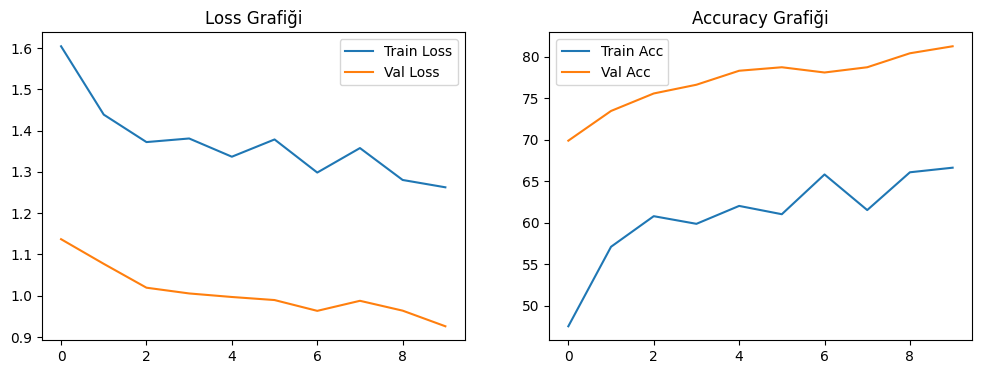


------------------------------------------------------
Epoch: 1
Train Loss: 1.2557016200378162 Train Acc: 67.14022625624835
Val Loss: 0.8501733978589375 Val Acc: 84.0
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1793806036981214 Train Acc: 69.71849513285977
Val Loss: 0.8276476343472798 Val Acc: 86.31578947368422
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.1385581503395272 Train Acc: 73.61220731386477
Val Loss: 0.8185717463493347 Val Acc: 87.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0415896908575748 Train Acc: 77.69008155748487
Val Loss: 0.8023587584495544 Val Acc: 87.57894736842105
------------------------------------------------------


------------------------------------------------------
Epoch: 5
T

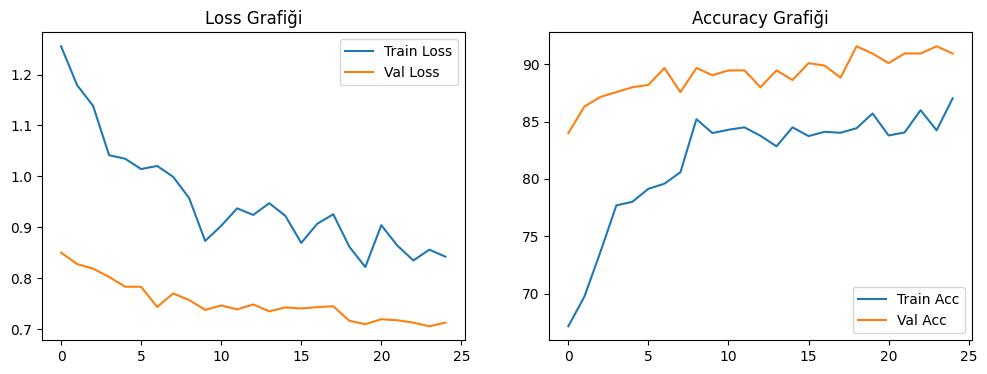

In [ ]:
resnet18_fc=resnet_fc(NUM_CLASSES, model_name='resnet18').to(device)
model_name="resnet18_fc"

results=auto_train_model(
    resnet18_fc,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet18_copy_unfreeze = copy.deepcopy(resnet18_fc)
resnet18_finetuned = resnet_finetune(resnet18_copy_unfreeze, unfreeze=1).to(device) #
model_name="resnet18_finetuned"

results=auto_train_model(
    resnet18_finetuned,
    model_name,
    loader_train,
    loader_val
)



size  512

------------------------------------------------------
Epoch: 1
Train Loss: 1.7210699640402274 Train Acc: 41.804788213627994
Val Loss: 1.1166918317476908 Val Acc: 71.36842105263158
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.443687590230413 Train Acc: 55.011838989739545
Val Loss: 1.0245687206586203 Val Acc: 77.47368421052632
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.3736401270417606 Train Acc: 60.852407261247045
Val Loss: 0.9494558691978454 Val Acc: 79.57894736842105
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.3554948803757418 Train Acc: 60.905024993422785
Val Loss: 0.9514799118041992 Val Acc: 78.10526315789474
------------------------------------------------------


--------------------------------------

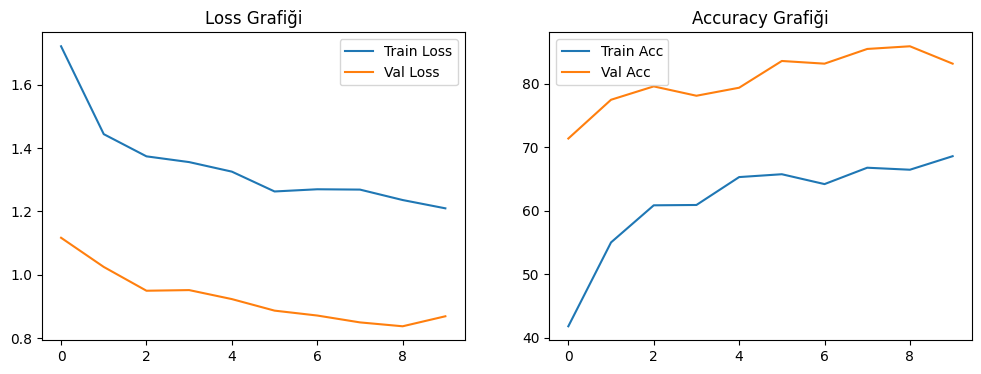


------------------------------------------------------
Epoch: 1
Train Loss: 1.2064227361639006 Train Acc: 69.24493554327809
Val Loss: 0.8170099417368571 Val Acc: 86.73684210526315
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1315165522719632 Train Acc: 73.66482504604052
Val Loss: 0.7821019570032756 Val Acc: 87.78947368421053
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.090697369154762 Train Acc: 76.08524072612471
Val Loss: 0.7868399103482564 Val Acc: 87.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0222947146712231 Train Acc: 75.84846093133386
Val Loss: 0.7566924889882406 Val Acc: 89.47368421052632
------------------------------------------------------


-----------------------------------------------------

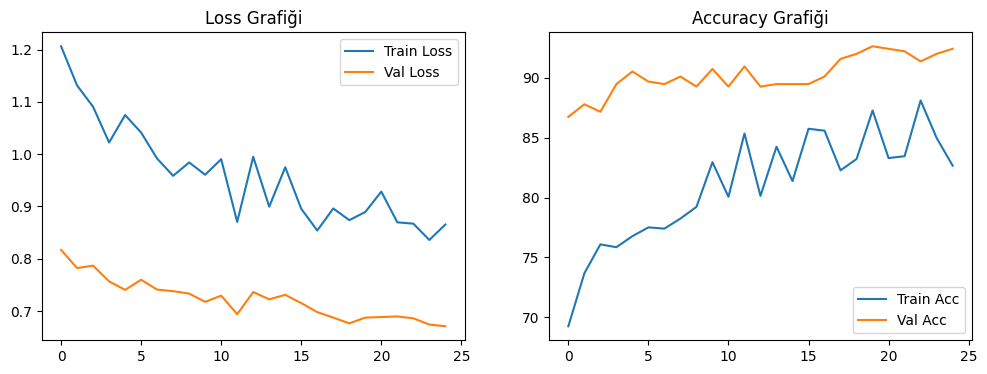

In [ ]:
resnet18_fc_cbam=resnet_fc(NUM_CLASSES, model_name='resnet18',cbam=True).to(device)
model_name="resnet18_fc_cbam"

results=auto_train_model(
    resnet18_fc_cbam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet18_copy_unfreeze_cbam = copy.deepcopy(resnet18_fc_cbam)
resnet18_finetuned_cbam = resnet_finetune(resnet18_copy_unfreeze_cbam, unfreeze=1,cbam=True).to(device) #
model_name="resnet18_finetuned_cbam"

results=auto_train_model(
    resnet18_finetuned_cbam,
    model_name,
    loader_train,
    loader_val
)


size  512
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (se): Sequential(
        (0): SE_module(
          (avg_pool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(64, 4, kernel_size=(1, 1), stride=(1, 1))
          (relu): ReLU(inplace=True)
          (fc2): Conv2d(4, 64, k

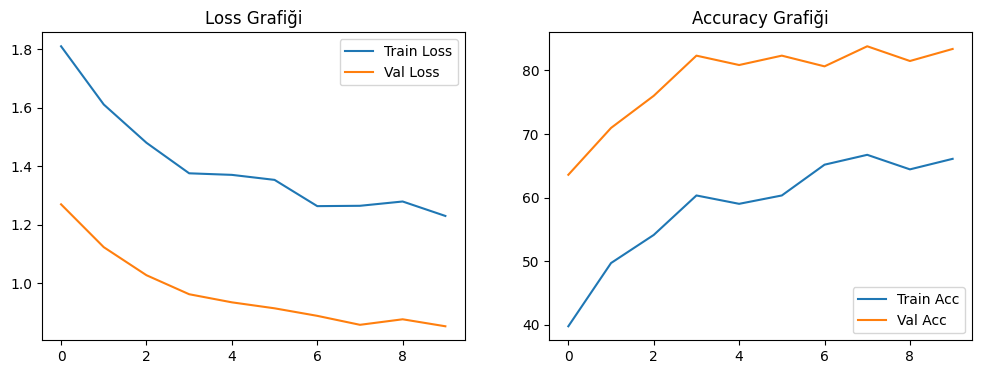


------------------------------------------------------
Epoch: 1
Train Loss: 1.2633688870598287 Train Acc: 67.61378584583004
Val Loss: 0.8607694784800212 Val Acc: 84.42105263157896
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1422349940828915 Train Acc: 72.98079452775585
Val Loss: 0.8337975223859151 Val Acc: 85.05263157894737
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.1168248858772407 Train Acc: 73.66482504604052
Val Loss: 0.7962647835413615 Val Acc: 87.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.1089967925007604 Train Acc: 74.76979742173113
Val Loss: 0.7790061752001445 Val Acc: 88.21052631578948
------------------------------------------------------


----------------------------------------------------

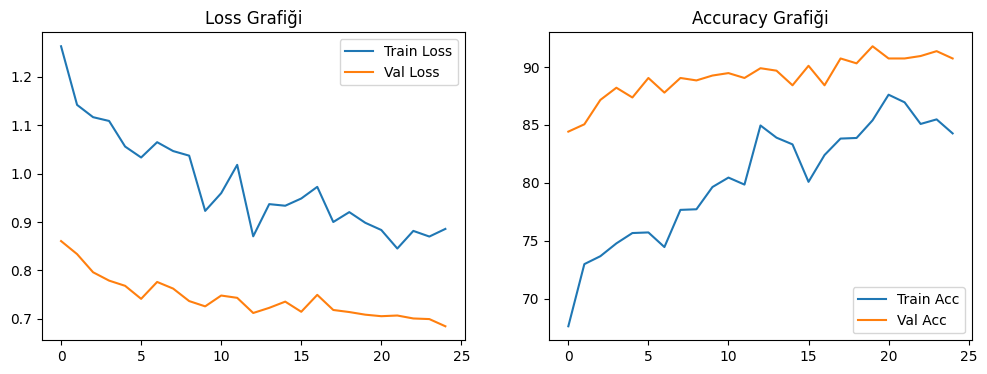

In [ ]:
resnet18_fc_secbam=resnet_fc(NUM_CLASSES,SE_toCBAM=True).to(device)
print(resnet18_fc_secbam)
model_name="resnet18_fc_secbam"

results=auto_train_model(
    resnet18_fc_secbam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet18_unfreeze_secbam = copy.deepcopy(resnet18_fc_secbam)
resnet18_finetuned_secbam = resnet_finetune(resnet18_unfreeze_secbam, unfreeze=1,SE_toCBAM=True).to(device) #
model_name="resnet18_finetuned_secbam"


results=auto_train_model(
    resnet18_finetuned_secbam,
    model_name,
    loader_train,
    loader_val
    )



### ***EfficientNet FineTuning*** & Cbam

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 210MB/s]


size  1280

------------------------------------------------------
Epoch: 1
Train Loss: 1.637304132726012 Train Acc: 47.224414627729544
Val Loss: 1.0851210832595826 Val Acc: 73.26315789473684
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.4056348019287366 Train Acc: 58.80031570639306
Val Loss: 1.0196286678314208 Val Acc: 77.89473684210526
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.353342873208663 Train Acc: 60.66824519863194
Val Loss: 0.9543425838152567 Val Acc: 80.84210526315789
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.3332232963137265 Train Acc: 61.27334911865299
Val Loss: 0.9574539025624593 Val Acc: 81.26315789473684
------------------------------------------------------


-----------------------------------------

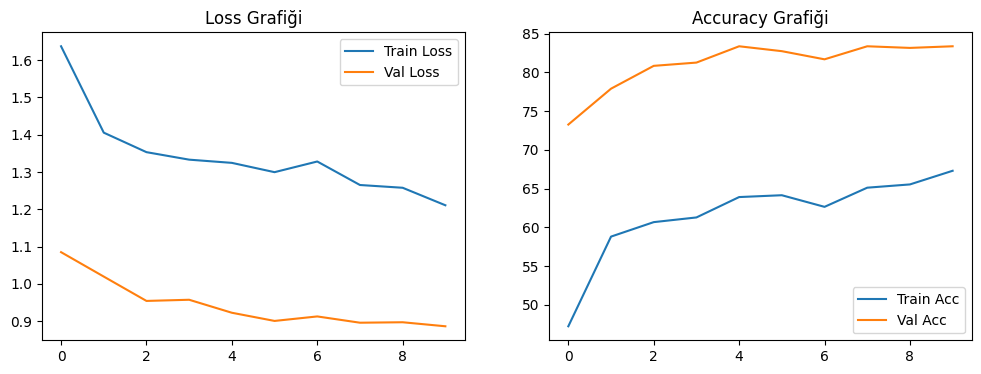


------------------------------------------------------
Epoch: 1
Train Loss: 1.236019072913322 Train Acc: 64.66719284398842
Val Loss: 0.8498309930165608 Val Acc: 83.78947368421052
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1612059689369523 Train Acc: 71.13917390160485
Val Loss: 0.8203105489412944 Val Acc: 85.89473684210527
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.1626242148776014 Train Acc: 70.4288345172323
Val Loss: 0.7985226511955261 Val Acc: 86.94736842105263
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0396582153664917 Train Acc: 75.11181268087346
Val Loss: 0.7728846828142802 Val Acc: 89.89473684210526
------------------------------------------------------


-----------------------------------------------------

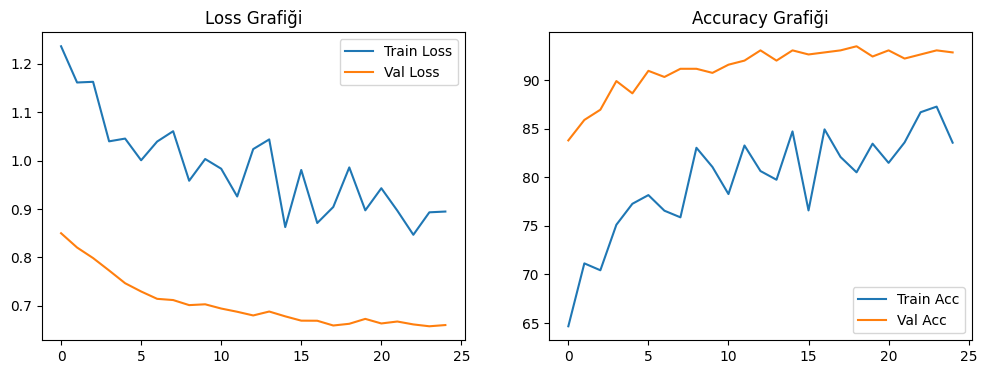

In [ ]:

efficientNet_fc = efficientnet_b0_fc(NUM_CLASSES).to(device)
model_name="efficientNet_fc"

results=auto_train_model(
    efficientNet_fc,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


efficientNet_copy_unfreeze = copy.deepcopy(efficientNet_fc)
efficientNet_finetuned = efficientnet_b0_finetune(efficientNet_copy_unfreeze, unfreeze=3).to(device) #
model_name="efficientNet_finetuned"

results=auto_train_model(
    efficientNet_finetuned,
    model_name,
    loader_train,
    loader_val
)



Position= features.1.0.block.1, Input Channel= 32
Index= 1
Parent= features.1.0.block
Position= features.2.0.block.2, Input Channel= 96
Index= 2
Parent= features.2.0.block
Position= features.2.1.block.2, Input Channel= 144
Index= 2
Parent= features.2.1.block
Position= features.3.0.block.2, Input Channel= 144
Index= 2
Parent= features.3.0.block
Position= features.3.1.block.2, Input Channel= 240
Index= 2
Parent= features.3.1.block
Position= features.4.0.block.2, Input Channel= 240
Index= 2
Parent= features.4.0.block
Position= features.4.1.block.2, Input Channel= 480
Index= 2
Parent= features.4.1.block
Position= features.4.2.block.2, Input Channel= 480
Index= 2
Parent= features.4.2.block
Position= features.5.0.block.2, Input Channel= 480
Index= 2
Parent= features.5.0.block
Position= features.5.1.block.2, Input Channel= 672
Index= 2
Parent= features.5.1.block
Position= features.5.2.block.2, Input Channel= 672
Index= 2
Parent= features.5.2.block
Position= features.6.0.block.2, Input Channel

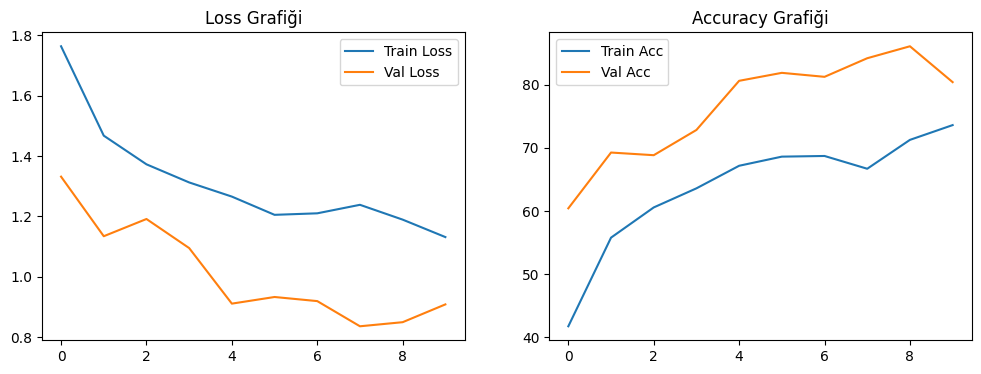


------------------------------------------------------
Epoch: 1
Train Loss: 1.0787209818343155 Train Acc: 75.61168113654301
Val Loss: 0.7621277530988058 Val Acc: 89.26315789473685
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1247527939932687 Train Acc: 74.71717968955538
Val Loss: 0.743940281867981 Val Acc: 90.31578947368422
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.119656687023259 Train Acc: 72.87555906340437
Val Loss: 0.7309826215108236 Val Acc: 89.6842105263158
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0392101963027185 Train Acc: 77.1902131018153
Val Loss: 0.7038285255432128 Val Acc: 92.0
------------------------------------------------------


------------------------------------------------------
Epoch: 5
Trai

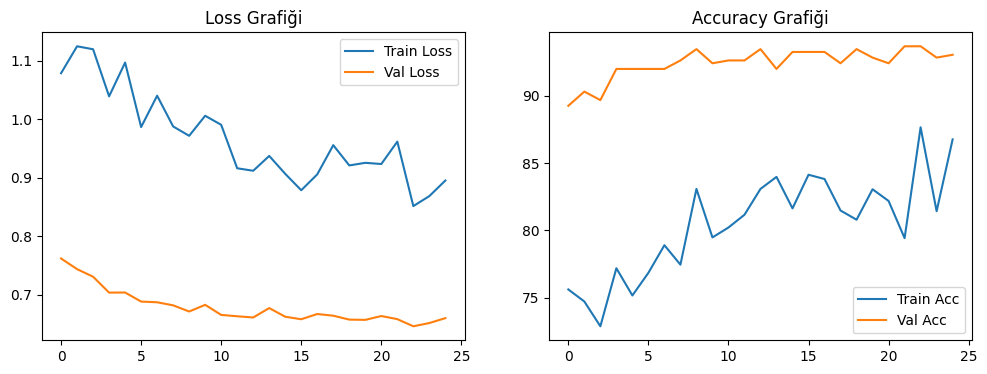

In [ ]:
efficientNet_fc_cbam = efficientnet_b0_fc(NUM_CLASSES,cbam=True).to(device)

model_name="efficientNet_fc_cbam"

results=auto_train_model(
    efficientNet_fc_cbam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


efficientNet_copy_unfreeze_cbam = copy.deepcopy(efficientNet_fc_cbam)
efficientNet_finetuned_cbam = efficientnet_b0_finetune(efficientNet_copy_unfreeze_cbam, unfreeze=3,cbam=True).to(device) #
model_name="efficientNet_finetuned_cbam"

results=auto_train_model(
    efficientNet_finetuned_cbam,
    model_name,
    loader_train,
    loader_val
)


size  1280
EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): Sequential(
            (0): SqueezeExcitation(
              (avgpool): AdaptiveAvgPool2d(output_size=1)
              (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
              (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
              (activation): SiLU(inplace=True)
              (scale_activation): Sigm

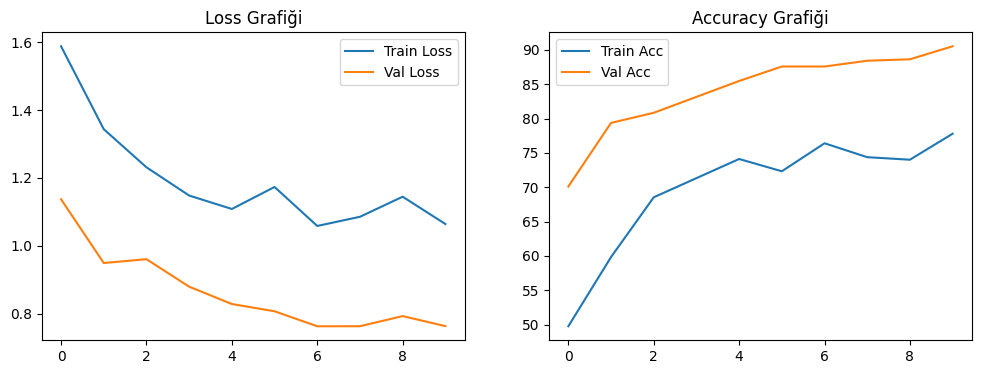


------------------------------------------------------
Epoch: 1
Train Loss: 1.0419611409932625 Train Acc: 79.71586424625099
Val Loss: 0.7092652241388957 Val Acc: 91.15789473684211
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 0.9926009754172894 Train Acc: 81.45224940805052
Val Loss: 0.696686844031016 Val Acc: 90.94736842105263
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 0.9540545108939419 Train Acc: 83.16232570376216
Val Loss: 0.6828640103340149 Val Acc: 92.0
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 0.96662205758215 Train Acc: 81.13654301499605
Val Loss: 0.6791851401329041 Val Acc: 91.78947368421052
------------------------------------------------------


------------------------------------------------------
Epoch: 5
Tra

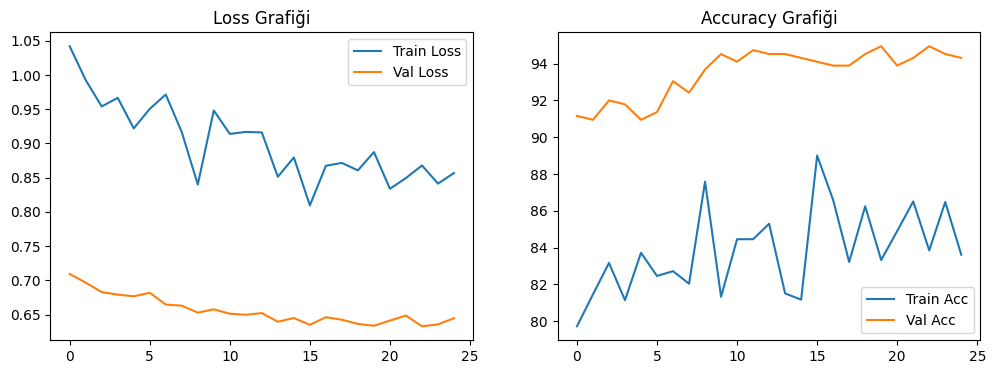

In [ ]:
efficientNet_fc_secbam=efficientnet_b0_fc(NUM_CLASSES,SE_toCBAM=True).to(device)
print(efficientNet_fc_secbam)
model_name="efficientNet_fc_secbam"

results=auto_train_model(
    efficientNet_fc_secbam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


efficientNet_copy_unfreeze_secbam = copy.deepcopy(efficientNet_fc_secbam)
efficientNet_finetuned_secbam = efficientnet_b0_finetune(efficientNet_copy_unfreeze_secbam, unfreeze=3,SE_toCBAM=True).to(device) #
model_name="efficientNet_finetuned_secbam"


results=auto_train_model(
    efficientNet_finetuned_secbam,
    model_name,
    loader_train,
    loader_val
    )


## ***SimAM***

Resnet+Simam

size  512

------------------------------------------------------
Epoch: 1
Train Loss: 1.6501249595850456 Train Acc: 46.8034727703236
Val Loss: 1.114469579855601 Val Acc: 70.52631578947368
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.4441200564889347 Train Acc: 58.27413838463562
Val Loss: 1.0613746802012125 Val Acc: 73.05263157894737
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.4415845590479233 Train Acc: 58.195211786372006
Val Loss: 1.0514537572860718 Val Acc: 76.0
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.378742713387273 Train Acc: 61.773217574322544
Val Loss: 1.0251614093780517 Val Acc: 74.73684210526315
------------------------------------------------------


------------------------------------------------------


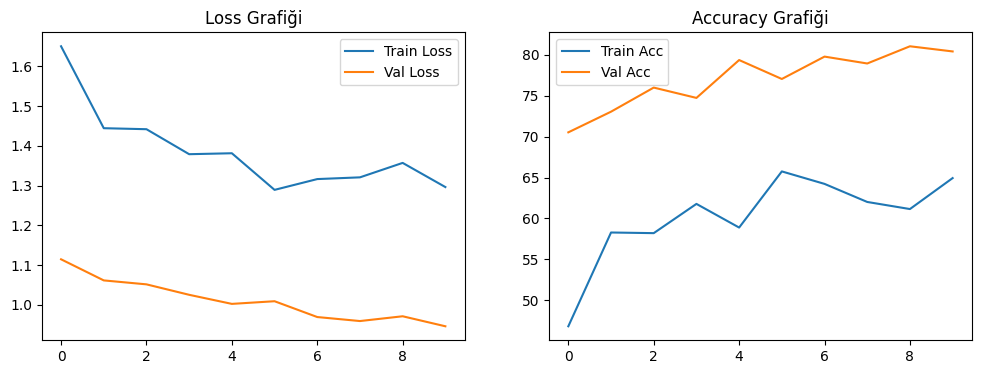


------------------------------------------------------
Epoch: 1
Train Loss: 1.2916636101338042 Train Acc: 63.45698500394633
Val Loss: 0.9031719128290813 Val Acc: 81.47368421052632
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1733377220249976 Train Acc: 73.37542751907394
Val Loss: 0.8429091215133667 Val Acc: 84.0
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.129488033907754 Train Acc: 72.66508813470139
Val Loss: 0.810163144270579 Val Acc: 86.10526315789474
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0644415411628594 Train Acc: 77.24283083399105
Val Loss: 0.801735500494639 Val Acc: 85.26315789473684
------------------------------------------------------


------------------------------------------------------
Epoch: 5
Tra

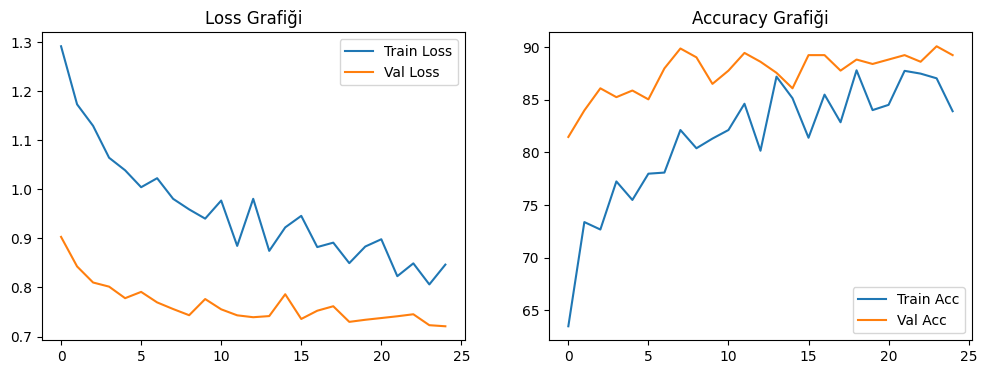

In [ ]:
resnet18_fc_simam=resnet_fc(NUM_CLASSES, model_name='resnet18',simam=True).to(device)
model_name="resnet18_fc_simam"

results=auto_train_model(
    resnet18_fc_simam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet18_copy_unfreeze_simam = copy.deepcopy(resnet18_fc_simam)
resnet18_finetuned_simam = resnet_finetune(resnet18_copy_unfreeze_simam, unfreeze=1).to(device) #
model_name="resnet18_finetuned_simam"


results=auto_train_model(
    resnet18_finetuned_simam,
    model_name,
    loader_train,
    loader_val
    )


### ***EfficientNet+SimAM***

size  1280

------------------------------------------------------
Epoch: 1
Train Loss: 2.038698098238777 Train Acc: 27.229676400947117
Val Loss: 1.6809603770573933 Val Acc: 44.21052631578947
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.9008482654555505 Train Acc: 33.70165745856354
Val Loss: 1.605086342493693 Val Acc: 47.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.8407294319457366 Train Acc: 36.17469087082347
Val Loss: 1.5478073994318644 Val Acc: 51.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.8163078752886348 Train Acc: 37.77953170218364
Val Loss: 1.5156577030817668 Val Acc: 54.315789473684205
------------------------------------------------------


------------------------------------------

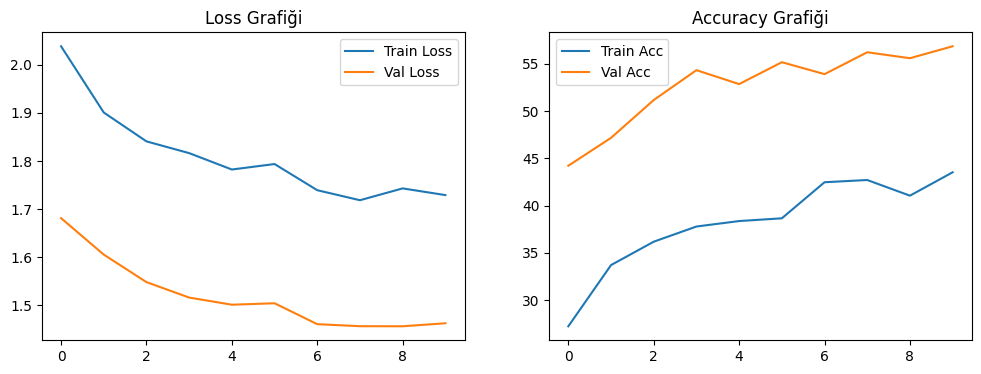


------------------------------------------------------
Epoch: 1
Train Loss: 1.6428703119774826 Train Acc: 47.59273875295975
Val Loss: 1.2943075299263 Val Acc: 61.473684210526315
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.5559353848465352 Train Acc: 52.223099184425145
Val Loss: 1.2159418026606241 Val Acc: 65.89473684210526
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.4637922799887777 Train Acc: 52.72296764009471
Val Loss: 1.1574365735054015 Val Acc: 67.57894736842105
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.4435567465149055 Train Acc: 57.9321231254933
Val Loss: 1.1214618682861328 Val Acc: 68.21052631578948
------------------------------------------------------


-----------------------------------------------------

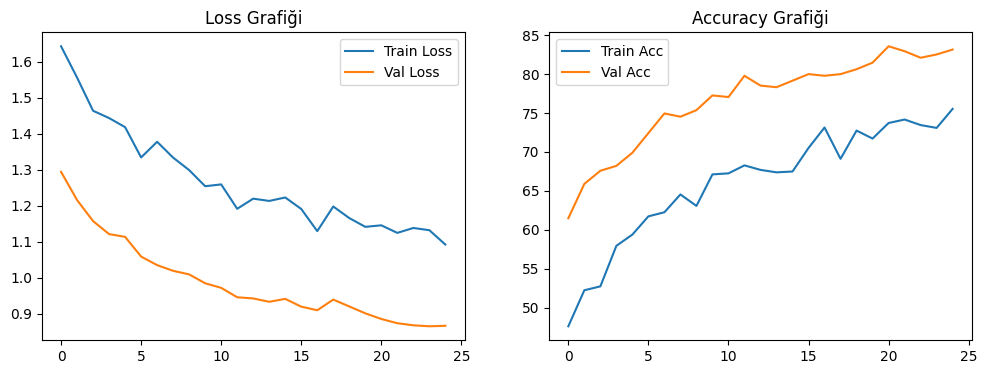

In [ ]:
efficientNet_fc_simam = efficientnet_b0_fc(NUM_CLASSES,simam=True).to(device)

model_name="efficientNet_fc_simam"

results=auto_train_model(
    efficientNet_fc_simam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)

efficientNet_copy_unfreeze_simam = copy.deepcopy(efficientNet_fc_simam)
efficientNet_finetuned_simam = efficientnet_b0_finetune(efficientNet_copy_unfreeze_simam, unfreeze=3).to(device) #
model_name="efficientNet_finetuned_simam"

results=auto_train_model(
    efficientNet_finetuned_simam,
    model_name,
    loader_train,
    loader_val
)


## ***CA***

size  512
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (ca): CoordinateAttention(
        (pool_height): AdaptiveAvgPool2d(output_size=(None, 1))
        (pool_width): AdaptiveAvgPool2d(output_size=(1, None))
        (shared_conv): Conv2d(64, 8, kernel_size=(1, 1), stride=(1, 1))
      

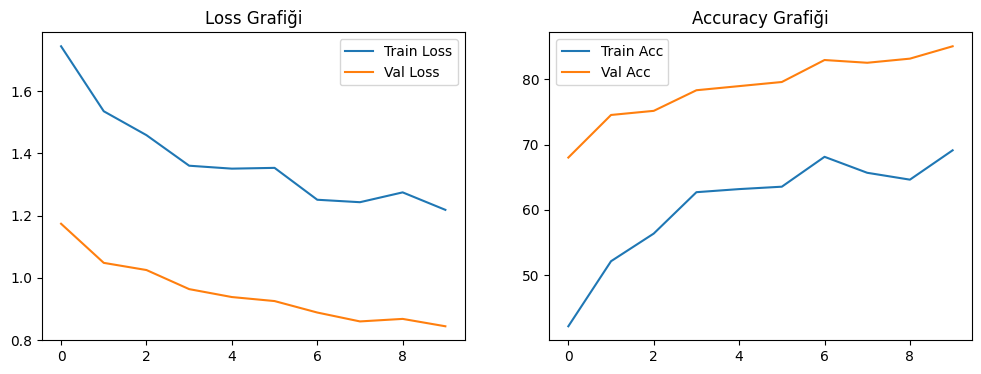


------------------------------------------------------
Epoch: 1
Train Loss: 1.181426758024873 Train Acc: 71.63904235727439
Val Loss: 0.8371931632359823 Val Acc: 83.57894736842105
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1701610509087057 Train Acc: 68.50828729281768
Val Loss: 0.8112619439760844 Val Acc: 85.26315789473684
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.2173165183107393 Train Acc: 70.0605103920021
Val Loss: 0.7896980365117391 Val Acc: 85.68421052631578
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0286992112127673 Train Acc: 77.71639042357275
Val Loss: 0.752601146697998 Val Acc: 88.42105263157895
------------------------------------------------------


------------------------------------------------------

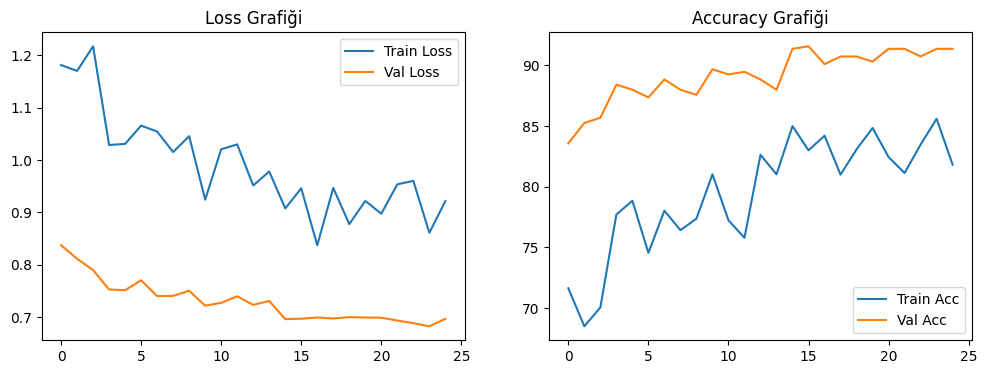

In [ ]:
resnet18_fc_ca=resnet_fc(NUM_CLASSES, model_name='resnet18',ca=True).to(device)
print(resnet18_fc_ca)
model_name="resnet18_fc_ca"

results=auto_train_model(
    resnet18_fc_ca,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet18_copy_unfreeze_ca = copy.deepcopy(resnet18_fc_ca)
resnet18_finetuned_ca = resnet_finetune(resnet18_copy_unfreeze_ca, unfreeze=1,ca=True).to(device) #
model_name="resnet18_finetuned_ca"


results=auto_train_model(
    resnet18_finetuned_ca,
    model_name,
    loader_train,
    loader_val
    )



size  512
ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (se): Sequential(
        (0): SE_module(
          (avg_pool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(64, 4, kernel_size=(1, 1), stride=(1, 1))
          (relu): ReLU(inplace=True)
          (fc2): Conv2d(4, 64, k

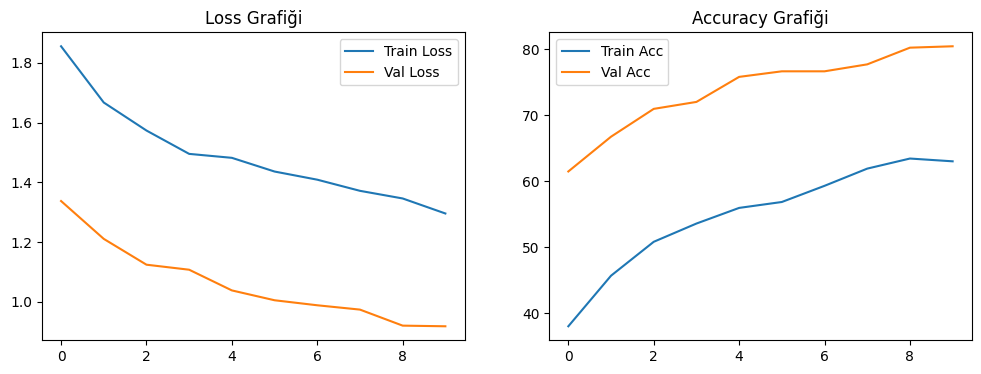


------------------------------------------------------
Epoch: 1
Train Loss: 1.299883533926571 Train Acc: 62.77295448566167
Val Loss: 0.9140364130338033 Val Acc: 81.47368421052632
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.2347383484119128 Train Acc: 65.982636148382
Val Loss: 0.8804211179415385 Val Acc: 82.73684210526315
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.2309890720022827 Train Acc: 64.40410418310971
Val Loss: 0.8329092343648274 Val Acc: 85.89473684210527
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.192328333353796 Train Acc: 71.98105761641673
Val Loss: 0.8223151803016663 Val Acc: 86.31578947368422
------------------------------------------------------


------------------------------------------------------


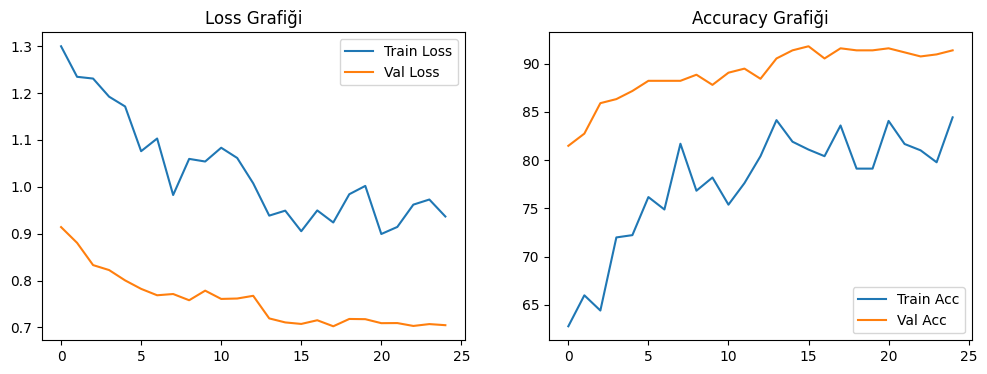

In [ ]:
resnet18_fc_se_ca=resnet_fc(NUM_CLASSES,SE_toCA=True).to(device)
print(resnet18_fc_se_ca)
model_name="resnet18_fc_se_ca"

results=auto_train_model(
    resnet18_fc_se_ca,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet18_fc_se_ca_unfreeze_cbam = copy.deepcopy(resnet18_fc_se_ca)
resnet18_finetuned_se_ca = resnet_finetune(resnet18_fc_se_ca_unfreeze_cbam, unfreeze=1,SE_toCA=True).to(device) #
model_name="resnet18_finetuned_se_ca"


results=auto_train_model(
    resnet18_finetuned_se_ca,
    model_name,
    loader_train,
    loader_val
    )


size  1280
EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): CoordinateAttention(
            (pool_height): AdaptiveAvgPool2d(output_size=(None, 1))
            (pool_width): AdaptiveAvgPool2d(output_size=(1, None))
            (shared_conv): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (shared_bn): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=T

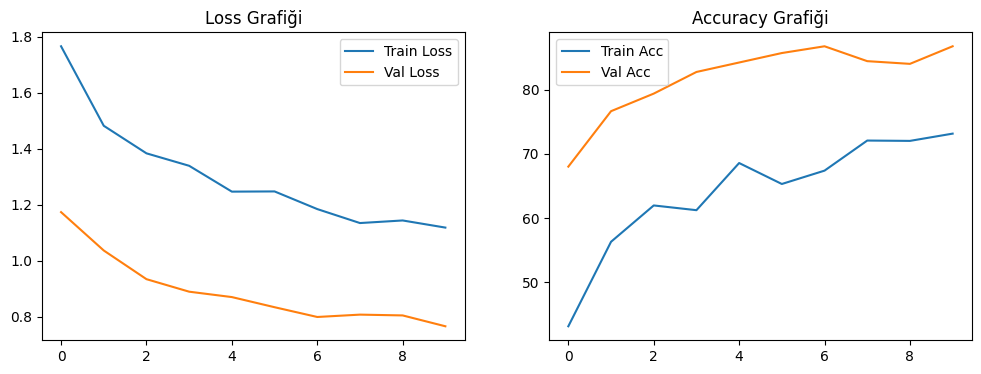


------------------------------------------------------
Epoch: 1
Train Loss: 1.0848231846544922 Train Acc: 72.79663246514076
Val Loss: 0.7681082407633464 Val Acc: 86.52631578947368
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.0864137942049683 Train Acc: 69.56064193633254
Val Loss: 0.7553249478340149 Val Acc: 88.21052631578948
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.0690875113511287 Train Acc: 78.13733228097868
Val Loss: 0.7620986064275106 Val Acc: 86.31578947368422
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.0173424407213676 Train Acc: 79.16337805840568
Val Loss: 0.7447527090708415 Val Acc: 88.21052631578948
------------------------------------------------------


---------------------------------------------------

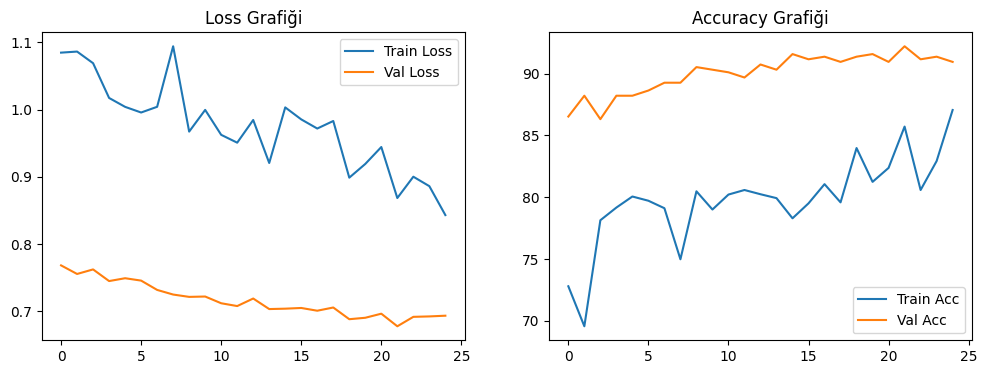

In [ ]:
efficientNet_fc_ca=efficientnet_b0_fc(NUM_CLASSES,ca=True).to(device)
print(efficientNet_fc_ca)
model_name="efficientNet_fc_ca"

results=auto_train_model(
    efficientNet_fc_ca,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)



efficientNet_copy_unfreeze_ca = copy.deepcopy(efficientNet_fc_ca)
efficientNet_finetuned_ca = efficientnet_b0_finetune(efficientNet_copy_unfreeze_ca, unfreeze=3,ca=True).to(device) #
model_name="efficientNet_finetuned_ca"


results=auto_train_model(
    efficientNet_finetuned_ca,
    model_name,
    loader_train,
    loader_val
    )



size  1280
EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): Sequential(
            (0): SqueezeExcitation(
              (avgpool): AdaptiveAvgPool2d(output_size=1)
              (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
              (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
              (activation): SiLU(inplace=True)
              (scale_activation): Sigm

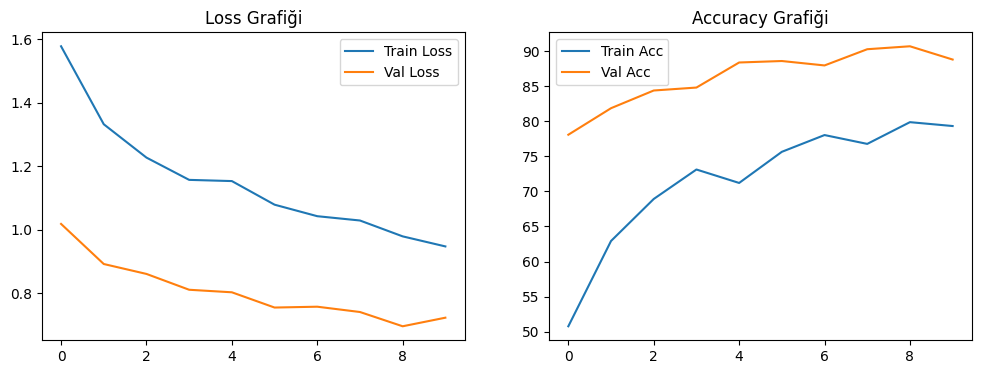


------------------------------------------------------
Epoch: 1
Train Loss: 1.0019857057002413 Train Acc: 80.71560115759011
Val Loss: 0.7017629345258077 Val Acc: 90.52631578947368
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 0.9246862896350252 Train Acc: 78.95290712970271
Val Loss: 0.6742615540822346 Val Acc: 92.21052631578948
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 0.9094497155742485 Train Acc: 81.03130755064457
Val Loss: 0.6752423167228698 Val Acc: 92.42105263157895
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 0.8917368500172591 Train Acc: 85.95106550907656
Val Loss: 0.6742729187011719 Val Acc: 91.78947368421052
------------------------------------------------------


---------------------------------------------------

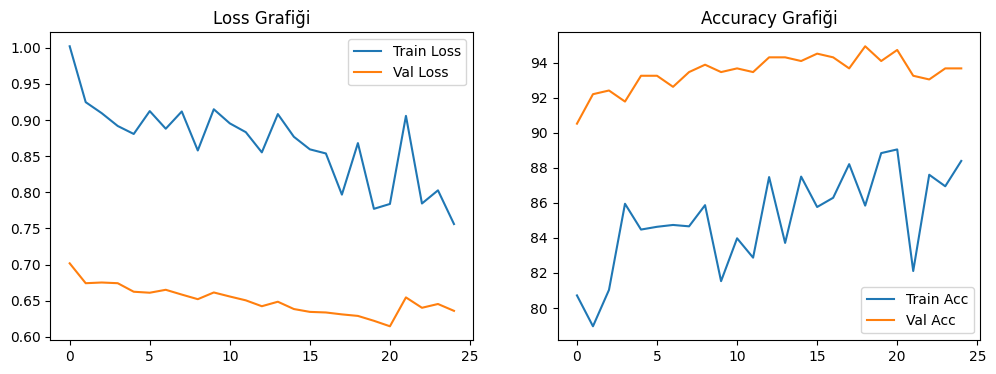

In [ ]:
efficientNet_fc_se_ca=efficientnet_b0_fc(NUM_CLASSES,SE_toCA=True).to(device)
print(efficientNet_fc_se_ca)
model_name="efficientNet_fc_se_ca"

results=auto_train_model(
    efficientNet_fc_se_ca,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)



efficientNet_copy_unfreeze_seca = copy.deepcopy(efficientNet_fc_se_ca)
efficientNet_finetuned_se_ca = efficientnet_b0_finetune(efficientNet_copy_unfreeze_seca, unfreeze=3,SE_toCA=True).to(device) #
model_name="efficientNet_finetuned_se_ca"


results=auto_train_model(
    efficientNet_finetuned_se_ca,
    model_name,
    loader_train,
    loader_val
    )



# ***DeformableConv2d***

In [ ]:

import torchvision.models as models
from torchvision.ops import deform_conv2d


class DeformableConv2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False):
        super(DeformableConv2d, self).__init__()
        self.stride = stride
        self.padding = padding
        self.kernel_size = kernel_size

        self.offset_generator = nn.Conv2d(
            in_channels,
            2 * kernel_size * kernel_size,
            kernel_size=kernel_size,
            stride=stride,
            padding=padding,
            bias=True
        )

        self.mask_generator = nn.Conv2d(
            in_channels,
            kernel_size * kernel_size,
            kernel_size=kernel_size,
            stride=stride,
            padding=padding,
            bias=True
        )

        self.main_conv = nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size=kernel_size,
            stride=stride,
            padding=padding,
            bias=bias
        )

        self._init_weights()

    def _init_weights(self):
        nn.init.constant_(self.offset_generator.weight, 0)
        nn.init.constant_(self.offset_generator.bias, 0)
        nn.init.constant_(self.mask_generator.weight, 0)
        nn.init.constant_(self.mask_generator.bias, 0)
        nn.init.kaiming_normal_(self.main_conv.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        offsets = self.offset_generator(x)
        mask = torch.sigmoid(self.mask_generator(x))
        return deform_conv2d(
            input=x,
            offset=offsets,
            weight=self.main_conv.weight,
            bias=self.main_conv.bias,
            stride=self.stride,
            padding=self.padding,
            dilation=1,
            mask=mask
        )


class EfficientNetWithDCN(nn.Module):
    def __init__(self, base_model, num_classes):
        super(EfficientNetWithDCN, self).__init__()

        self.features = base_model.features

        self.bottleneck = nn.Conv2d(1280, 256, kernel_size=1, bias=False)
        self.bottleneck_bn = nn.BatchNorm2d(256)
        self.bottleneck_act = nn.SiLU(inplace=True)

        self.dcn_neck = DeformableConv2d(
            in_channels=256,
            out_channels=256,
            kernel_size=3,
            padding=1
        )
        self.neck_bn = nn.BatchNorm2d(256)
        self.neck_act = nn.SiLU(inplace=True)

        self.avgpool = nn.AdaptiveAvgPool2d(1)

        self.classifier = nn.Sequential(
            nn.Dropout(p=0.3, inplace=True),
            nn.Linear(256, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(512, num_classes),
        )

    def forward(self, x):
        x = self.features(x)

        x = self.bottleneck(x)
        x = self.bottleneck_bn(x)
        x = self.bottleneck_act(x)

        x = self.dcn_neck(x)
        x = self.neck_bn(x)
        x = self.neck_act(x)

        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.classifier(x)
        return x


def efficientnet_upgraded_func(num_classes, model=None, cbam=False, simam=False, SE_toCA=False, SE_toCBAM=False):
    if model is None:
        model = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.DEFAULT)

    model = model.to(device)

    if cbam:
        model = replace_se_cbam(model)
    if simam:
        model = replace_se_simam(model)
    if SE_toCA:
        model = se_ca(model)
    if SE_toCBAM:
        model = se_cbam(model)

    for param in model.features.parameters():
        param.requires_grad = False

    if cbam:
        for name, param in model.named_parameters():
            if "mlp" in name or "conv_spatial" in name:
                param.requires_grad = True

    if SE_toCA or SE_toCBAM:
        modules_list = (CoordinateAttention, CBAM_module, SE_module)
        for module in model.modules():
            if isinstance(module, modules_list):
                for param in module.parameters():
                    param.requires_grad = True

    final_model = EfficientNetWithDCN(base_model=model, num_classes=num_classes).to(device)

    for param in final_model.bottleneck.parameters(): param.requires_grad = True
    for param in final_model.dcn_neck.parameters(): param.requires_grad = True
    for param in final_model.classifier.parameters(): param.requires_grad = True

    return final_model


def efficientnet_finetune_upgraded_func(model, unfreeze=3, cbam=False, simam=False, SE_toCA=False, SE_toCBAM=False):
    for param in model.parameters():
        param.requires_grad = False

    modules_list = (CoordinateAttention, CBAM_module, SE_module, SimAM_module)
    for module in model.features.modules():
        if isinstance(module, modules_list):
            for param in module.parameters():
                param.requires_grad = True

    for param in model.bottleneck.parameters(): param.requires_grad = True
    for param in model.dcn_neck.parameters(): param.requires_grad = True
    for param in model.classifier.parameters(): param.requires_grad = True

    total_layers = len(model.features)
    unfreeze_start = max(0, total_layers - unfreeze)

    for i in range(unfreeze_start, total_layers):
        for param in model.features[i].parameters():
            param.requires_grad = True

    return model



def resnet18_with_dcn(num_classes, dcn_layers=1, model=None, cbam=False, simam=False, ca=False, SE_toCA=False, SE_toCBAM=False):
    if model is None:
        model = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)

    model = model.to(device)

    if cbam:
        model = resnet_cbam(model)
    if simam:
        model = resnet_simam(model)
    if ca:
        model = resNet_ca(model)
    if SE_toCA:
        model = resnet_se(model)
        model = se_ca(model)
    if SE_toCBAM:
        model = resnet_se(model)
        model = se_cbam(model)

    for param in model.parameters():
        param.requires_grad = False

    def replace_conv_block(block):
        conv1 = block.conv1
        block.conv1 = DeformableConv2d(
            in_channels=conv1.in_channels,
            out_channels=conv1.out_channels,
            kernel_size=conv1.kernel_size[0],
            stride=conv1.stride[0],
            padding=conv1.padding[0],
            bias=(conv1.bias is not None)
        ).to(device)

        conv2 = block.conv2
        block.conv2 = DeformableConv2d(
            in_channels=conv2.in_channels,
            out_channels=conv2.out_channels,
            kernel_size=conv2.kernel_size[0],
            stride=conv2.stride[0],
            padding=conv2.padding[0],
            bias=(conv2.bias is not None)
        ).to(device)

    layers_to_modify = []
    if dcn_layers == 1:
        layers_to_modify = [model.layer4]
    elif dcn_layers == 2:
        layers_to_modify = [model.layer3, model.layer4]
    elif dcn_layers == 3:
        layers_to_modify = [model.layer2, model.layer3, model.layer4]

    for layer in layers_to_modify:
        for block in layer:
            replace_conv_block(block)

    input_features = model.fc.in_features
    model.fc = nn.Sequential(
        nn.Linear(input_features, 512),
        nn.BatchNorm1d(512),
        nn.ReLU(),
        nn.Dropout(0.5),
        nn.Linear(512, 256),
        nn.BatchNorm1d(256),
        nn.ReLU(),
        nn.Dropout(0.3),
        nn.Linear(256, num_classes)
    ).to(device)

    attn_modules = (CBAM_module, CoordinateAttention, SE_module, SimAM_module)
    for module in model.modules():
        if isinstance(module, attn_modules):
            for param in module.parameters():
                param.requires_grad = True

    for layer in layers_to_modify:
        for block in layer:
            for param in block.conv1.parameters():
                param.requires_grad = True
            for param in block.conv2.parameters():
                param.requires_grad = True

    for param in model.fc.parameters():
        param.requires_grad = True

    return model


def resnet18_finetune_with_dcn(model, unfreeze=1, cbam=False, simam=False, ca=False, SE_toCA=False, SE_toCBAM=False):
    for param in model.parameters():
        param.requires_grad = False

    attn_modules = (CBAM_module, CoordinateAttention, SE_module, SimAM_module)
    for module in model.modules():
        if isinstance(module, attn_modules):
            for param in module.parameters():
                param.requires_grad = True

    for param in model.fc.parameters():
        param.requires_grad = True

    layers_to_unfreeze = []
    if unfreeze >= 1:
        layers_to_unfreeze.append("layer4")
    if unfreeze >= 2:
        layers_to_unfreeze.append("layer3")
    if unfreeze >= 3:
        layers_to_unfreeze.append("layer2")
    if unfreeze >= 4:
        layers_to_unfreeze.append("layer1")

    for name, param in model.named_parameters():
        for layer in layers_to_unfreeze:
            if layer in name:
                param.requires_grad = True
                break

    return model


------------------------------------------------------
Epoch: 1
Train Loss: 1.5391823484116243 Train Acc: 53.249144961852146
Val Loss: 1.0283412337303162 Val Acc: 76.21052631578948
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.3444592121268522 Train Acc: 63.430676137858455
Val Loss: 0.932497751712799 Val Acc: 81.05263157894737
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.22974487763493 Train Acc: 69.21862667719022
Val Loss: 0.8197551131248474 Val Acc: 86.31578947368422
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.1098930299782954 Train Acc: 75.40121020784004
Val Loss: 0.8214741547902426 Val Acc: 85.68421052631578
------------------------------------------------------


----------------------------------------------------

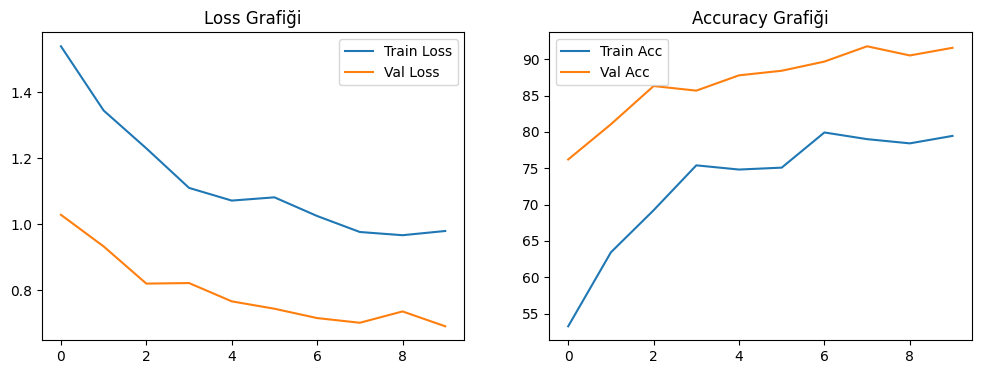


------------------------------------------------------
Epoch: 1
Train Loss: 0.9117977649223905 Train Acc: 82.79400157853196
Val Loss: 0.6626644094785055 Val Acc: 92.84210526315789
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 0.9872859265623974 Train Acc: 80.24204156800842
Val Loss: 0.672220245997111 Val Acc: 93.47368421052632
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 0.9847568033122215 Train Acc: 80.66298342541437
Val Loss: 0.6665488759676615 Val Acc: 93.47368421052632
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 0.9476195228199998 Train Acc: 81.66272033675348
Val Loss: 0.6592377781867981 Val Acc: 93.6842105263158
------------------------------------------------------


-----------------------------------------------------

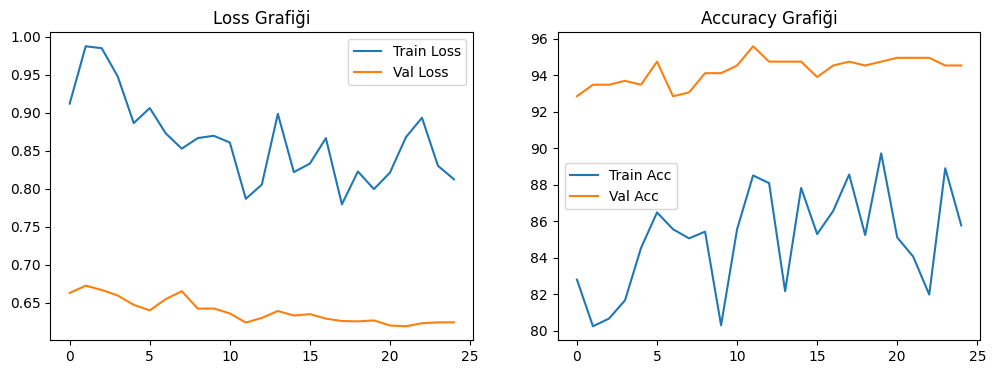

In [ ]:
efficientnet_dcn = efficientnet_upgraded_func(NUM_CLASSES,SE_toCA=True).to(device)
model_name = "efficientnet_dcn"

results=auto_train_model(
    efficientnet_dcn,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


efficientNet_copy_unfreeze_dcn = copy.deepcopy(efficientnet_dcn)

efficientNet_dcn_finetuned = efficientnet_finetune_upgraded_func(efficientNet_copy_unfreeze_dcn, unfreeze=3,SE_toCA=True).to(device)
model_name = "efficientNet_dcn_finetuned"

results=auto_train_model(
    efficientNet_dcn_finetuned,
    model_name,
    loader_train,
    loader_val,
)


Position= features.1.0.block.1, Input Channel= 32
Index= 1
Parent= features.1.0.block
Position= features.2.0.block.2, Input Channel= 96
Index= 2
Parent= features.2.0.block
Position= features.2.1.block.2, Input Channel= 144
Index= 2
Parent= features.2.1.block
Position= features.3.0.block.2, Input Channel= 144
Index= 2
Parent= features.3.0.block
Position= features.3.1.block.2, Input Channel= 240
Index= 2
Parent= features.3.1.block
Position= features.4.0.block.2, Input Channel= 240
Index= 2
Parent= features.4.0.block
Position= features.4.1.block.2, Input Channel= 480
Index= 2
Parent= features.4.1.block
Position= features.4.2.block.2, Input Channel= 480
Index= 2
Parent= features.4.2.block
Position= features.5.0.block.2, Input Channel= 480
Index= 2
Parent= features.5.0.block
Position= features.5.1.block.2, Input Channel= 672
Index= 2
Parent= features.5.1.block
Position= features.5.2.block.2, Input Channel= 672
Index= 2
Parent= features.5.2.block
Position= features.6.0.block.2, Input Channel

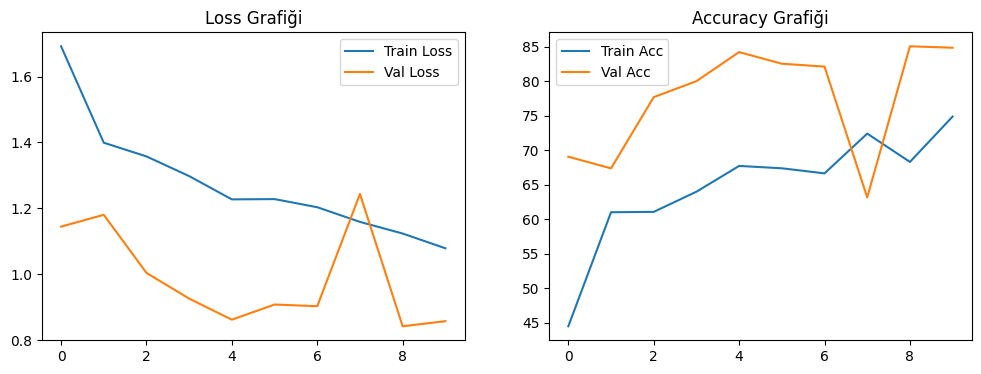


------------------------------------------------------
Epoch: 1
Train Loss: 1.0961373608653284 Train Acc: 73.00710339384374
Val Loss: 0.7481819828351338 Val Acc: 89.05263157894737
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.0470071389895528 Train Acc: 78.16364114706657
Val Loss: 0.7445115049680074 Val Acc: 88.8421052631579
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.0212282723739368 Train Acc: 78.18995001315443
Val Loss: 0.7247194409370422 Val Acc: 89.89473684210526
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.014803963548997 Train Acc: 78.4004209418574
Val Loss: 0.7223915298779805 Val Acc: 89.26315789473685
------------------------------------------------------


------------------------------------------------------

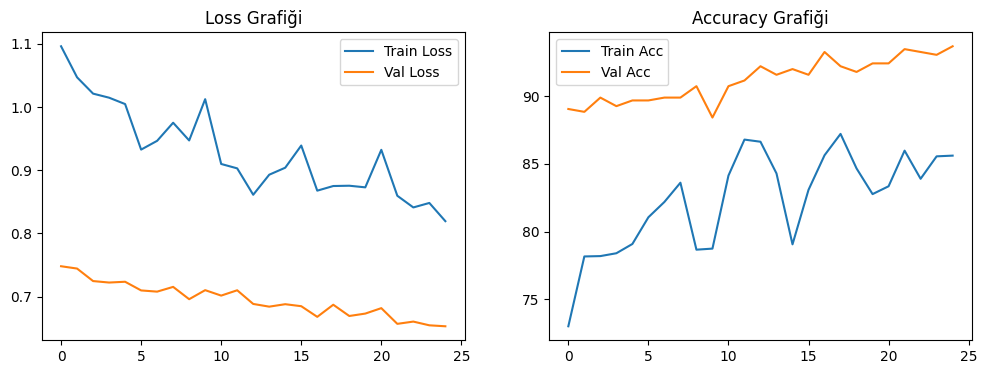

In [ ]:
efficientnet_dcn_cbam = efficientnet_upgraded_func(NUM_CLASSES,cbam=True).to(device)
model_name = "efficientnet_dcn_cbam"

results=auto_train_model(
    efficientnet_dcn_cbam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)

efficientNet_copy_unfreeze_cbam_dcn = copy.deepcopy(efficientnet_dcn_cbam)

efficientNet_dcn_finetuned_cbam = efficientnet_finetune_upgraded_func(efficientNet_copy_unfreeze_cbam_dcn, unfreeze=3,cbam=True).to(device)
model_name = "efficientNet_dcn_finetuned_cbam"

results=auto_train_model(
    efficientNet_dcn_finetuned_cbam,
    model_name,
    loader_train,
    loader_val,
)



------------------------------------------------------
Epoch: 1
Train Loss: 1.9382115522352588 Train Acc: 33.25440673506972
Val Loss: 1.4435511112213135 Val Acc: 57.263157894736835
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.683413384341392 Train Acc: 45.461720599842145
Val Loss: 1.3036266724268595 Val Acc: 61.473684210526315
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.6333244918775158 Train Acc: 47.882136279926335
Val Loss: 1.307877532641093 Val Acc: 60.8421052631579
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.5658969358235848 Train Acc: 51.85477505919495
Val Loss: 1.2479674855868021 Val Acc: 65.47368421052632
------------------------------------------------------


--------------------------------------------------

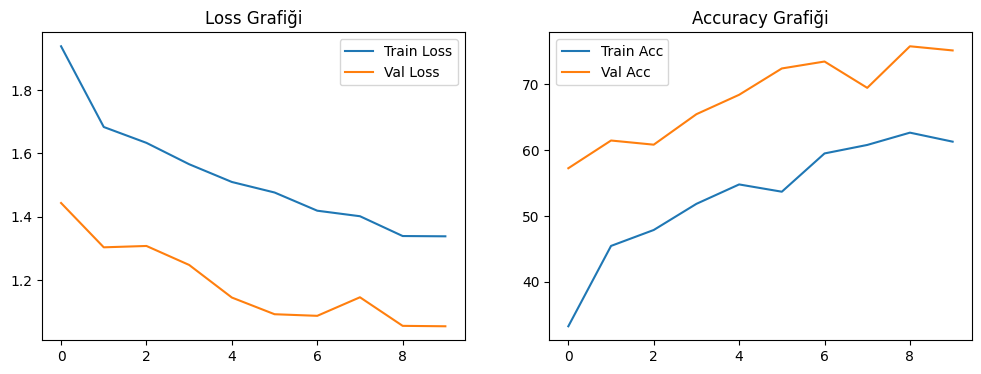


------------------------------------------------------
Epoch: 1
Train Loss: 1.2344718931101952 Train Acc: 68.27150749802684
Val Loss: 0.9403887907663981 Val Acc: 79.78947368421052
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.2491559872106344 Train Acc: 67.66640357800578
Val Loss: 0.9192927519480387 Val Acc: 78.73684210526316
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.226102736316809 Train Acc: 67.24546172059985
Val Loss: 0.8923958539962769 Val Acc: 80.21052631578948
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.2006566714839775 Train Acc: 70.45514338332018
Val Loss: 0.8841402649879455 Val Acc: 81.26315789473684
------------------------------------------------------


----------------------------------------------------

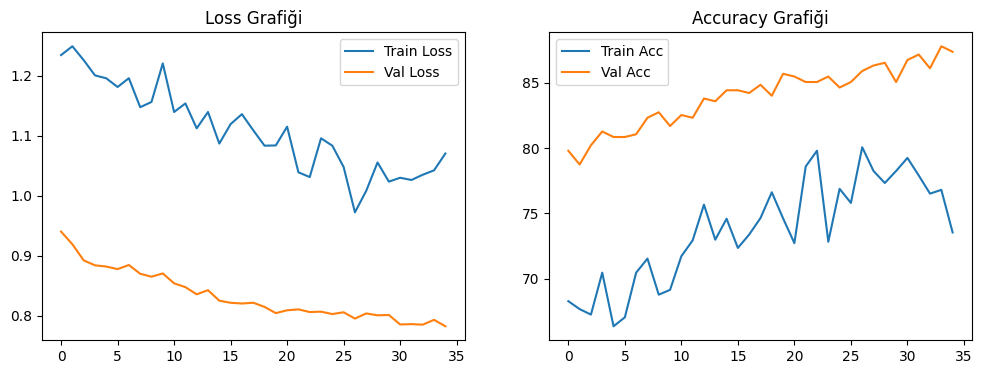

In [ ]:
resnet_dcn = resnet18_with_dcn(NUM_CLASSES,dcn_layers=2,SE_toCA=True).to(device)
model_name = "resnet_dcn"

results=auto_train_model(
    resnet_dcn,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet_deform_copy_unfreeze = copy.deepcopy(resnet_dcn)

resnet_dcn_finetuned = resnet18_finetune_with_dcn(resnet_deform_copy_unfreeze, unfreeze=2,SE_toCA=True).to(device)
model_name = "resnet_dcn_finetuned"

results=auto_train_model(
    resnet_dcn_finetuned,
    model_name,
    loader_train,
    loader_val,
    epochs=35,
    learning_rate=5e-5
)



------------------------------------------------------
Epoch: 1
Train Loss: 1.9208581427566143 Train Acc: 33.41225993159695
Val Loss: 1.497238008181254 Val Acc: 55.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.6551666710557056 Train Acc: 46.59300184162063
Val Loss: 1.2850819905598958 Val Acc: 63.1578947368421
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.5026238235104985 Train Acc: 53.72270455143383
Val Loss: 1.2471925179163614 Val Acc: 64.63157894736841
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.417515565367306 Train Acc: 58.195211786372006
Val Loss: 1.1094141999880474 Val Acc: 72.0
------------------------------------------------------


------------------------------------------------------
Epoch: 5
Tra

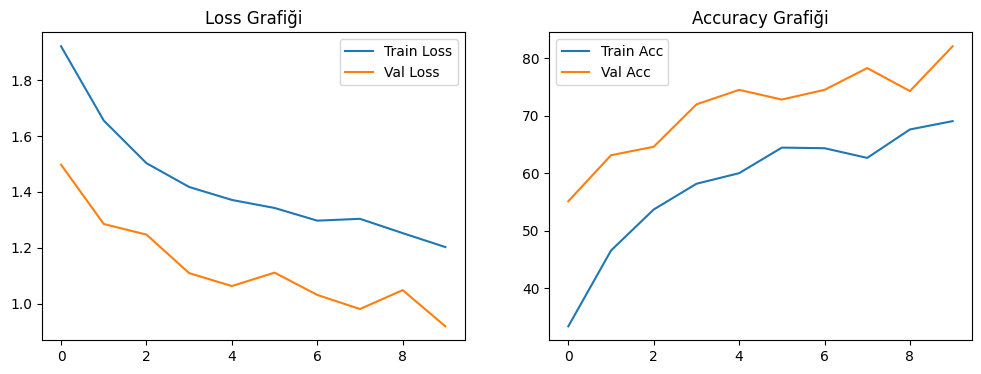


------------------------------------------------------
Epoch: 1
Train Loss: 1.1284252390140246 Train Acc: 72.03367534859247
Val Loss: 0.8452377478281657 Val Acc: 85.05263157894737
------------------------------------------------------


------------------------------------------------------
Epoch: 2
Train Loss: 1.1535442681873547 Train Acc: 71.03393843725335
Val Loss: 0.8411022265752156 Val Acc: 83.78947368421052
------------------------------------------------------


------------------------------------------------------
Epoch: 3
Train Loss: 1.0793226601696815 Train Acc: 75.32228360957643
Val Loss: 0.834484601020813 Val Acc: 84.63157894736842
------------------------------------------------------


------------------------------------------------------
Epoch: 4
Train Loss: 1.067762875256418 Train Acc: 75.50644567219152
Val Loss: 0.8216404755910237 Val Acc: 85.26315789473684
------------------------------------------------------


-----------------------------------------------------

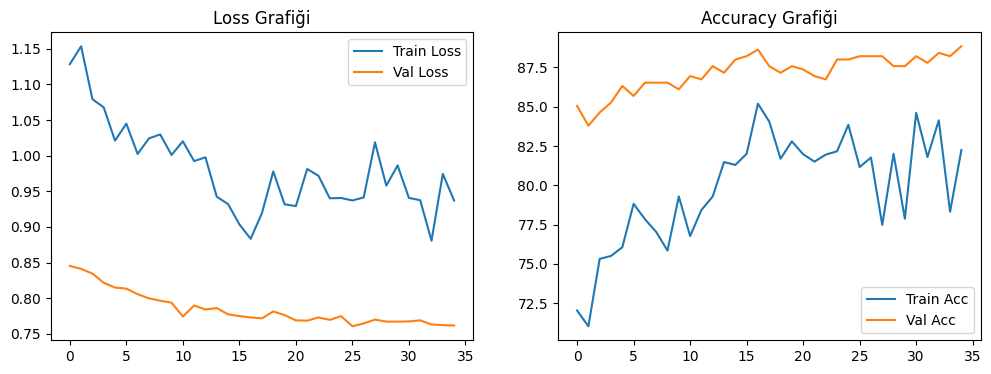

In [ ]:
resnet_dcn_cbam = resnet18_with_dcn(NUM_CLASSES,dcn_layers=2,cbam=True).to(device)
model_name = "resnet_dcn_cbam"

results=auto_train_model(
    resnet_dcn_cbam,
    model_name,
    loader_train,
    loader_val,
    learning_rate=LEARNING_RATE_HEAD,
    epochs=EPOCHS_HEAD,
)


resnet_dcn_copy_unfreeze_cbam = copy.deepcopy(resnet_dcn_cbam)

resnet_dcn_cbam_finetuned_cbam = resnet18_finetune_with_dcn(resnet_dcn_copy_unfreeze_cbam, unfreeze=2,cbam=True).to(device)
model_name = "resnet_dcn_cbam_finetuned_cbam"

results=auto_train_model(
    resnet_dcn_cbam_finetuned_cbam,
    model_name,
    loader_train,
    loader_val,
    epochs=35,
    learning_rate=5e-5
)


# ***Sonuçlar***

In [ ]:
!pip install grad-cam opencv-python matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 105.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 76.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 101.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 66.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 49.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 104.5 

In [ ]:
import os
import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
from torchvision import transforms as T
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.image import show_cam_on_image


def find_test_image(root_dir):
    image_files = []
    for dirpath, _, filenames in os.walk(root_dir):
        for f in filenames:
            if f.lower().endswith(('.jpg', '.jpeg', '.png')):
                image_files.append(os.path.join(dirpath, f))

    if not image_files:
        print(f"UYARI: {root_dir} içinde resim bulunamadı!")
        return None

    selected_img = np.random.choice(image_files)
    print(f"Seçilen resim: {selected_img}")
    return selected_img

def get_img_tensor(img_path):
    device = 'cuda' if torch.cuda.is_available() else 'cpu'

    img = Image.open(img_path).convert('RGB')
    transform = T.Compose([
        T.Resize((224, 224)),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img).unsqueeze(0).to(device)

    rgb_img = cv2.imread(img_path, 1)[:, :, ::-1]
    rgb_img = cv2.resize(rgb_img, (224, 224))
    rgb_img = np.float32(rgb_img) / 255

    return img_tensor, rgb_img

def visualize_gradcam(model, target_layer, img_tensor, rgb_img, ax, title="Grad-CAM"):
    try:
        cam = GradCAM(model=model, target_layers=[target_layer])
        grayscale_cam = cam(input_tensor=img_tensor)[0, :]
        visualization = show_cam_on_image(rgb_img, grayscale_cam, use_rgb=True)

        ax.imshow(visualization)
        ax.set_title(title, fontsize=16)
        ax.axis("off")
    except Exception as e:
        print(f"Hata ({title}): {e}")
        ax.text(0.5, 0.5, "Görselleştirme Hatası", ha='center', fontsize=12)
        ax.axis("off")


def get_target_layer(model):
    """
    GradCAM için çalışan aktif katmanları bulur.
    Özellikle DCN katmanlarında 'main_conv' yerine 'wrapper' sınıfı hedefler.
    """
    target_layers = []

    if hasattr(model, 'dcn_neck'):
        target_layers = [model.dcn_neck]

    elif hasattr(model, 'layer4'):
        last_block = model.layer4[-1]

        if hasattr(last_block, 'conv2'):
            if isinstance(last_block.conv2, torch.nn.Module):
                target_layers = [last_block.conv2]
            else:
                target_layers = [last_block]
        else:
             target_layers = [model.layer4[-1]]

    elif hasattr(model, 'features'):
        target_layers = [model.features[-1]]

    if not target_layers:
        print("Uyarı: Otomatik katman bulunamadı, son Conv2d aranıyor...")
        for name, module in dict(model.named_modules()).items().__reversed__():
            if isinstance(module, torch.nn.Conv2d):
                target_layers = [module]
                break

    return target_layers

def compare_gradcams_final(models_dict, img_path, device):
    if img_path is None:
        print("Resim yolu hatalı/boş.")
        return

    input_tensor, rgb_image = get_img_tensor(img_path)
    input_tensor.requires_grad = True

    num_models = len(models_dict)
    cols = 4
    rows = math.ceil((num_models + 1) / cols)

    plt.figure(figsize=(20, 5 * rows))

    ax = plt.subplot(rows, cols, 1)
    ax.imshow(rgb_image)
    ax.set_title("Orijinal Input", fontsize=14, fontweight='bold', color='green')
    ax.axis("off")

    for i, (name, model) in enumerate(models_dict.items()):
        ax = plt.subplot(rows, cols, i + 2)
        model.to(device)
        model.eval()

        model.zero_grad()

        target_layers = get_target_layer(model)

        if target_layers:
            try:
                cam = GradCAM(model=model, target_layers=target_layers)

                grayscale_cam = cam(input_tensor=input_tensor.clone())[0, :]

                visualization = show_cam_on_image(rgb_image, grayscale_cam, use_rgb=True)
                ax.imshow(visualization)

                title = name.replace("efficientNet", "EffNet").replace("resnet18", "ResNet").replace("finetuned", "").replace("_", " ")
                ax.set_title(title, fontsize=10)
                ax.axis("off")

                del cam

            except Exception as e:
                err_msg = str(e).split('\n')[0]
                print(f"CAM Hatası ({name}): {err_msg}")
                ax.text(0.5, 0.5, "CAM Error", ha='center', color='red')
                ax.axis("off")
        else:
            print(f"Uyarı ({name}): Hedef katman bulunamadı.")
            ax.text(0.5, 0.5, "No Layer", ha='center')
            ax.axis("off")

    plt.tight_layout()
    plt.show()



In [ ]:
def run_all_tests(models_dict, loader_test, device, classes):
    print(f"\n{'='*10} Test Süreci {'='*10}")
    for name, model in models_dict.items():
        print(f"Test Ediliyor: {name}")
        test_model(model, loader_test, device, classes)

def plot_performance_results(global_results, exclude_filter="fc"):
    filtered = {k: v for k, v in global_results.items() if exclude_filter not in k}
    data = []

    for name, m in filtered.items():
        data.append({
            "Model": name,
            "Best Acc (%)": round(max(m["val_acc"]), 2),
            "Final Acc (%)": round(m["val_acc"][-1], 2),
            "Best Loss": round(min(m["val_loss"]), 4),
            "Final Loss": round(m["val_loss"][-1], 4)
        })

    df = pd.DataFrame(data).sort_values("Best Acc (%)", ascending=False).reset_index(drop=True)
    print("\n--- Model Karşılaştırma Tablosu ---")
    display(df)

    plt.figure(figsize=(15, 6))

    plt.subplot(1, 2, 1)
    for name, m in filtered.items():
        plt.plot(m["val_acc"], label=name)
    plt.title('Validation Accuracy')
    plt.grid(True)
    plt.legend()

    plt.subplot(1, 2, 2)
    for name, m in filtered.items():
        plt.plot(m["val_loss"], label=name)
    plt.title('Validation Loss')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()
    plt.show()

def save_all_models(models_dict, save_folder):
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)

    print("\n--- Modeller Kaydediliyor ---")
    for name, model in models_dict.items():
        safe_name = name.replace(" ", "_") + ".pth"
        full_path = os.path.join(save_folder, safe_name)

        torch.save(model.state_dict(), full_path)
        print(f"Kaydedildi: {full_path}")


========== Test Süreci ==========
Test Ediliyor: customVGG
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.72      0.62      0.67        53
      Food Organics       0.70      0.77      0.73        39
              Glass       0.87      0.64      0.74        42
              Metal       0.71      0.53      0.61        77
Miscellaneous Trash       0.37      0.33      0.35        52
              Paper       0.72      0.53      0.61        53
            Plastic       0.62      0.85      0.72        84
      Textile Trash       0.27      0.36      0.31        28
         Vegetation       0.74      0.96      0.84        48

           accuracy                           0.64       476
          macro avg       0.64      0.62      0.62       476
       weighted avg       0.65      0.64      0.63       476



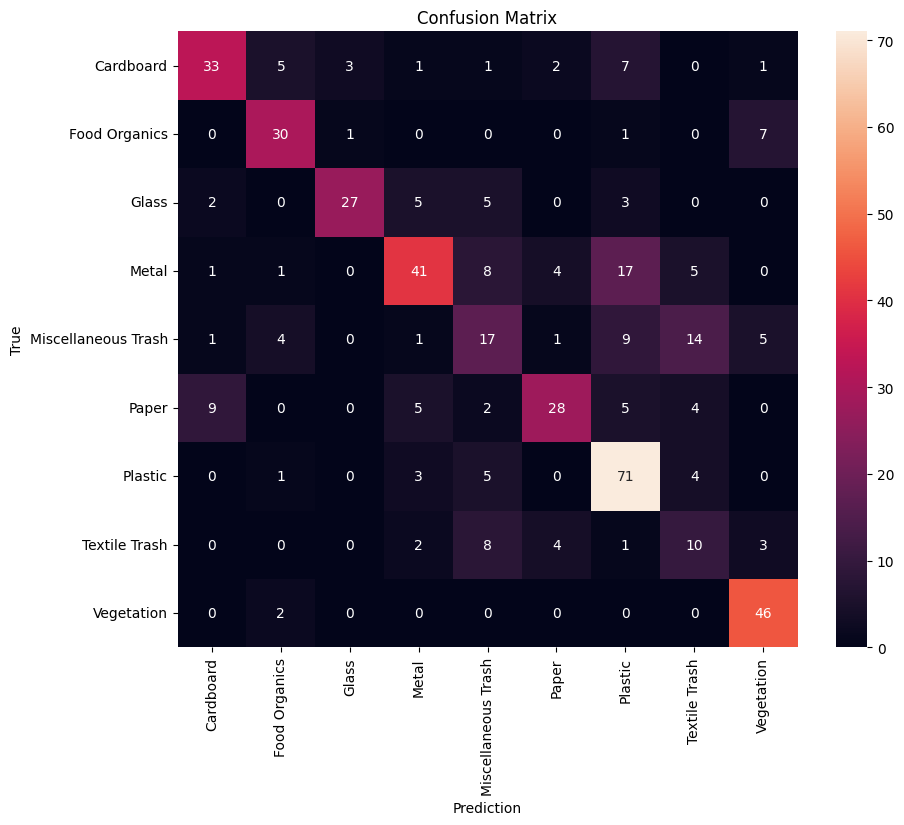

Test Ediliyor: mobileNet2_finetuned
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.93      0.96      0.94        53
      Food Organics       0.95      0.95      0.95        39
              Glass       0.95      0.90      0.93        42
              Metal       0.94      0.95      0.94        77
Miscellaneous Trash       0.90      0.83      0.86        52
              Paper       1.00      0.87      0.93        53
            Plastic       0.88      0.95      0.91        84
      Textile Trash       0.93      0.89      0.91        28
         Vegetation       0.92      1.00      0.96        48

           accuracy                           0.93       476
          macro avg       0.93      0.92      0.93       476
       weighted avg       0.93      0.93      0.93       476



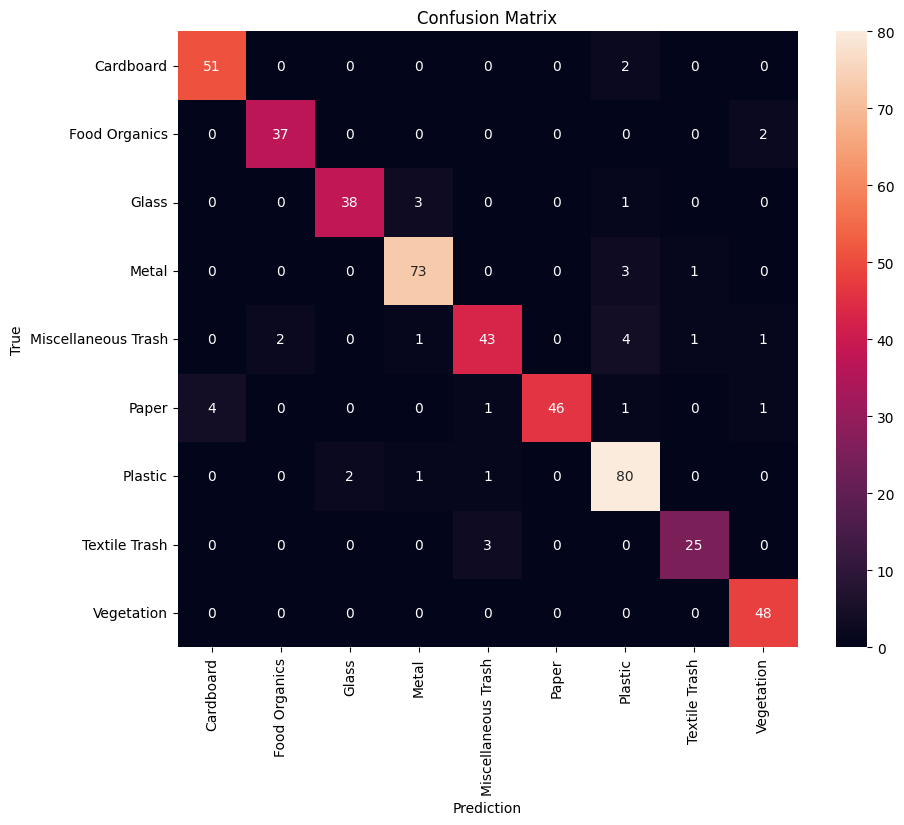

Test Ediliyor: resnet18_finetuned
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.93      0.96      0.94        53
      Food Organics       0.93      0.97      0.95        39
              Glass       0.95      0.98      0.96        42
              Metal       0.90      0.90      0.90        77
Miscellaneous Trash       0.93      0.77      0.84        52
              Paper       0.96      0.87      0.91        53
            Plastic       0.88      0.93      0.90        84
      Textile Trash       0.81      0.93      0.87        28
         Vegetation       0.98      0.98      0.98        48

           accuracy                           0.92       476
          macro avg       0.92      0.92      0.92       476
       weighted avg       0.92      0.92      0.92       476



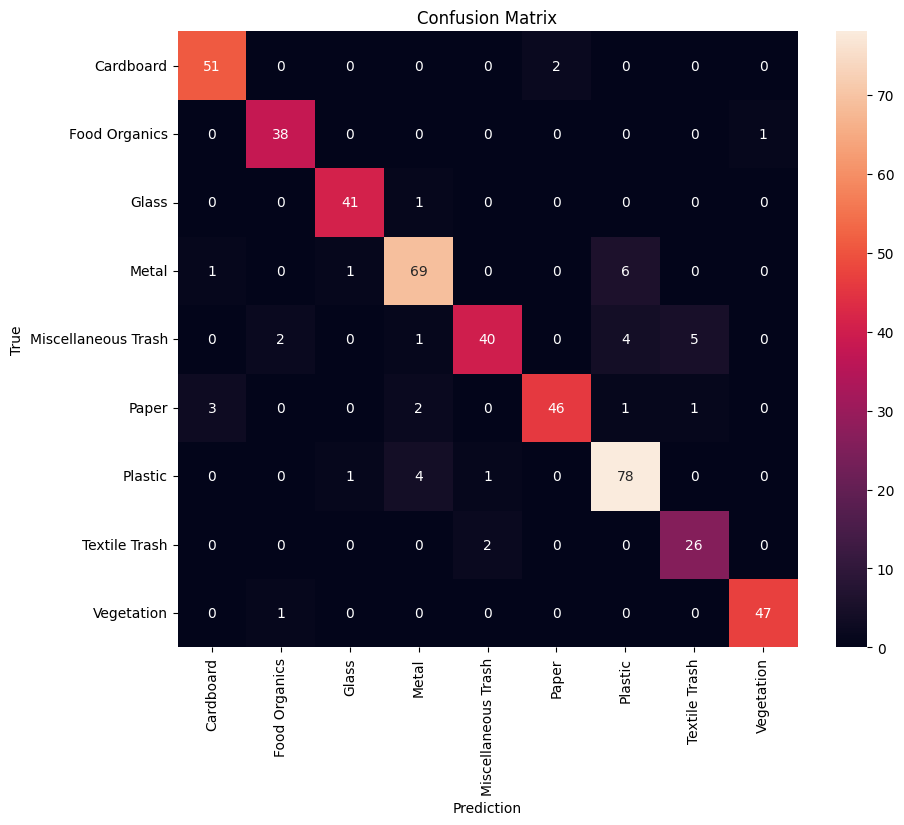

Test Ediliyor: resnet18_finetuned_cbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.96      1.00      0.98        53
      Food Organics       0.95      0.92      0.94        39
              Glass       0.95      0.90      0.93        42
              Metal       0.90      0.97      0.94        77
Miscellaneous Trash       0.91      0.81      0.86        52
              Paper       0.98      0.94      0.96        53
            Plastic       0.92      0.90      0.91        84
      Textile Trash       0.86      0.89      0.88        28
         Vegetation       0.92      0.98      0.95        48

           accuracy                           0.93       476
          macro avg       0.93      0.93      0.93       476
       weighted avg       0.93      0.93      0.93       476



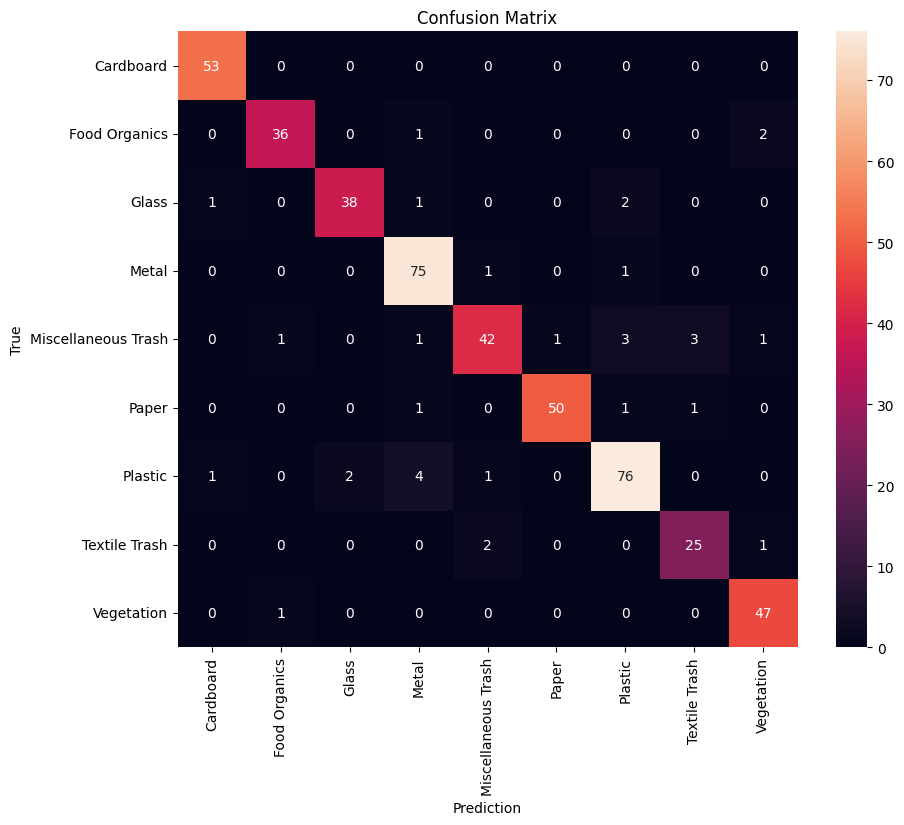

Test Ediliyor: resnet18_finetuned_secbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.95      0.98      0.96        53
      Food Organics       0.95      0.95      0.95        39
              Glass       0.91      0.98      0.94        42
              Metal       0.91      0.92      0.92        77
Miscellaneous Trash       0.91      0.83      0.87        52
              Paper       0.96      0.92      0.94        53
            Plastic       0.91      0.88      0.90        84
      Textile Trash       0.90      0.93      0.91        28
         Vegetation       0.92      0.98      0.95        48

           accuracy                           0.92       476
          macro avg       0.92      0.93      0.93       476
       weighted avg       0.92      0.92      0.92       476



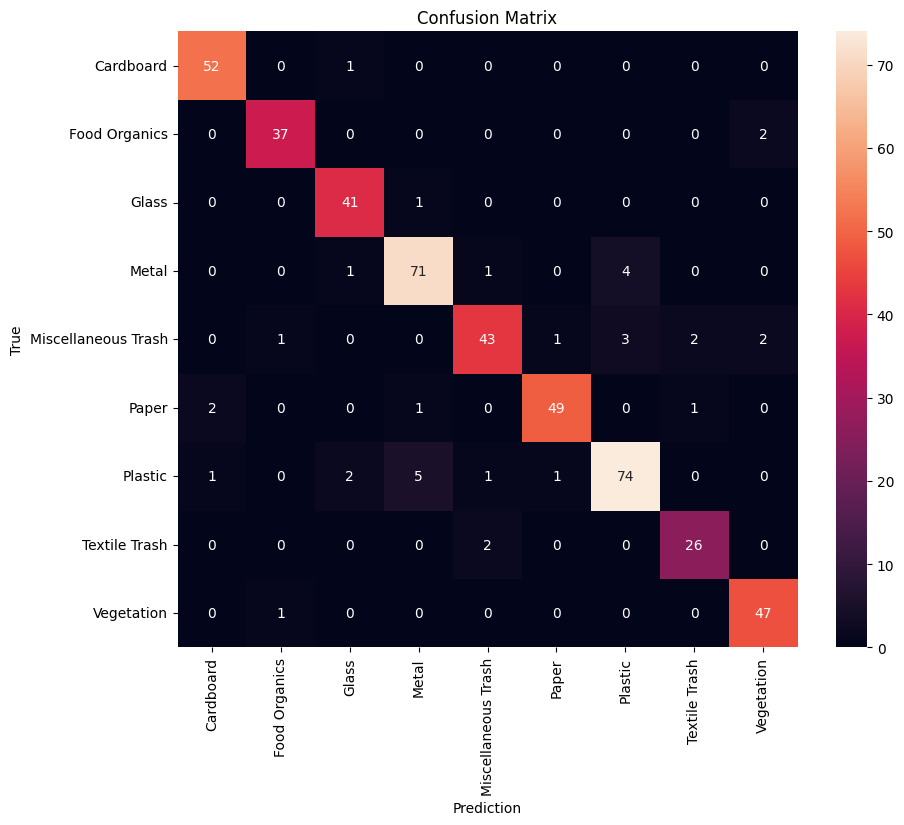

Test Ediliyor: efficientNet_finetuned
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.93      0.96      0.94        53
      Food Organics       0.97      0.95      0.96        39
              Glass       0.91      0.98      0.94        42
              Metal       0.93      0.96      0.94        77
Miscellaneous Trash       0.92      0.87      0.89        52
              Paper       0.96      0.89      0.92        53
            Plastic       0.93      0.92      0.92        84
      Textile Trash       0.93      0.93      0.93        28
         Vegetation       0.96      0.98      0.97        48

           accuracy                           0.93       476
          macro avg       0.94      0.94      0.94       476
       weighted avg       0.94      0.93      0.93       476



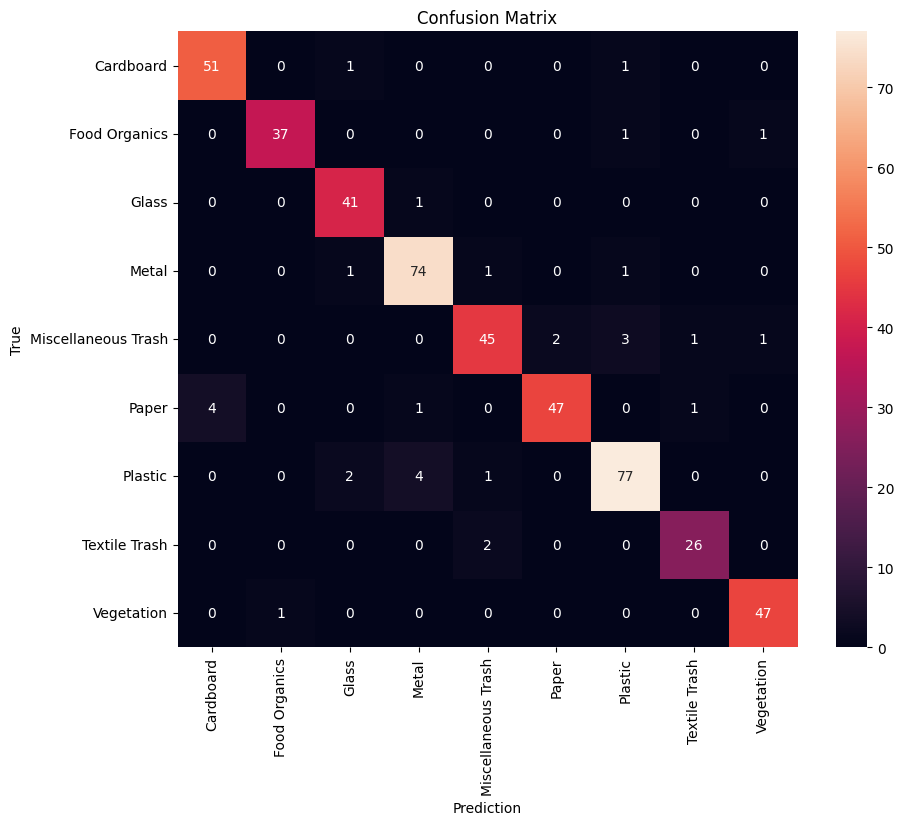

Test Ediliyor: efficientNet_finetuned_cbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.98      0.98      0.98        53
      Food Organics       0.95      0.97      0.96        39
              Glass       0.95      0.93      0.94        42
              Metal       0.89      0.97      0.93        77
Miscellaneous Trash       0.91      0.79      0.85        52
              Paper       0.95      0.98      0.96        53
            Plastic       0.94      0.92      0.93        84
      Textile Trash       0.89      0.89      0.89        28
         Vegetation       0.98      0.98      0.98        48

           accuracy                           0.94       476
          macro avg       0.94      0.94      0.94       476
       weighted avg       0.94      0.94      0.94       476



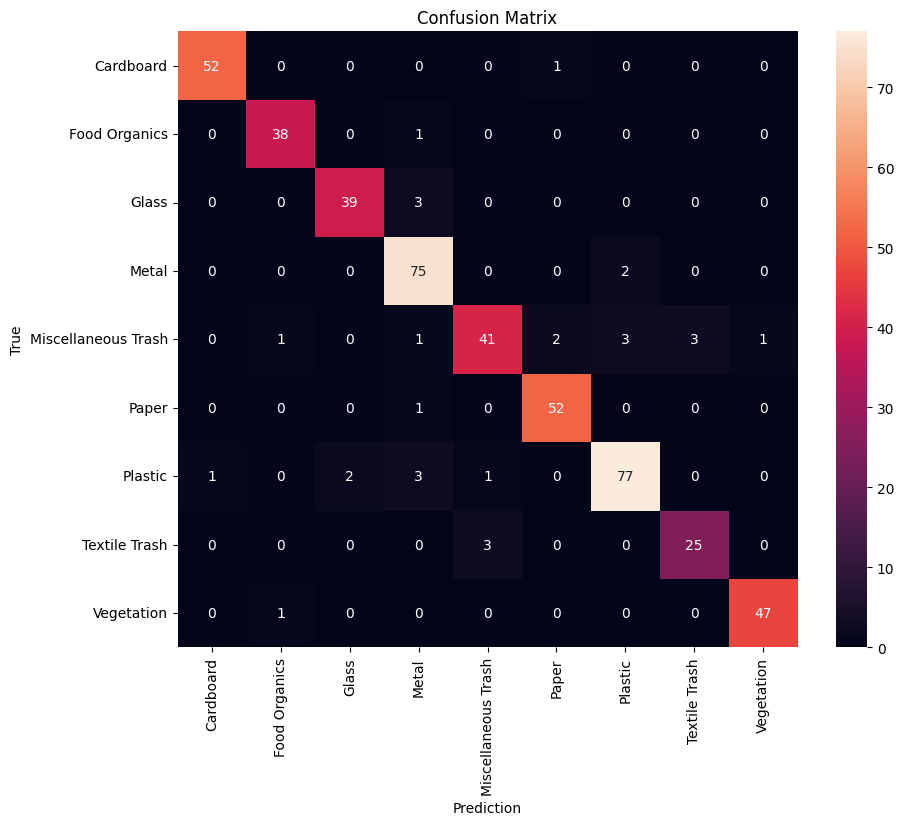

Test Ediliyor: efficientNet_finetuned_secbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       1.00      0.92      0.96        53
      Food Organics       0.93      0.95      0.94        39
              Glass       0.87      0.93      0.90        42
              Metal       0.96      0.95      0.95        77
Miscellaneous Trash       0.86      0.85      0.85        52
              Paper       0.96      0.94      0.95        53
            Plastic       0.89      0.92      0.90        84
      Textile Trash       0.92      0.82      0.87        28
         Vegetation       0.92      0.98      0.95        48

           accuracy                           0.92       476
          macro avg       0.92      0.92      0.92       476
       weighted avg       0.92      0.92      0.92       476



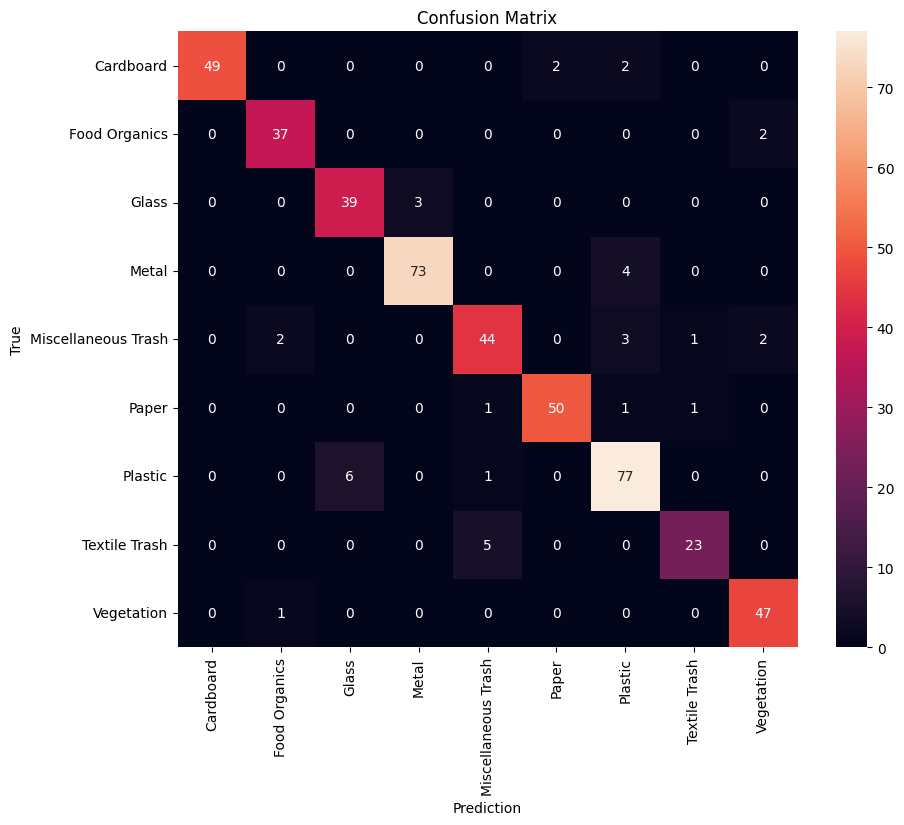

Test Ediliyor: resnet18_finetuned_simam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.94      0.92      0.93        53
      Food Organics       0.93      0.95      0.94        39
              Glass       0.95      0.95      0.95        42
              Metal       0.89      0.92      0.90        77
Miscellaneous Trash       0.87      0.75      0.80        52
              Paper       0.94      0.92      0.93        53
            Plastic       0.89      0.93      0.91        84
      Textile Trash       0.87      0.93      0.90        28
         Vegetation       0.96      0.94      0.95        48

           accuracy                           0.91       476
          macro avg       0.91      0.91      0.91       476
       weighted avg       0.91      0.91      0.91       476



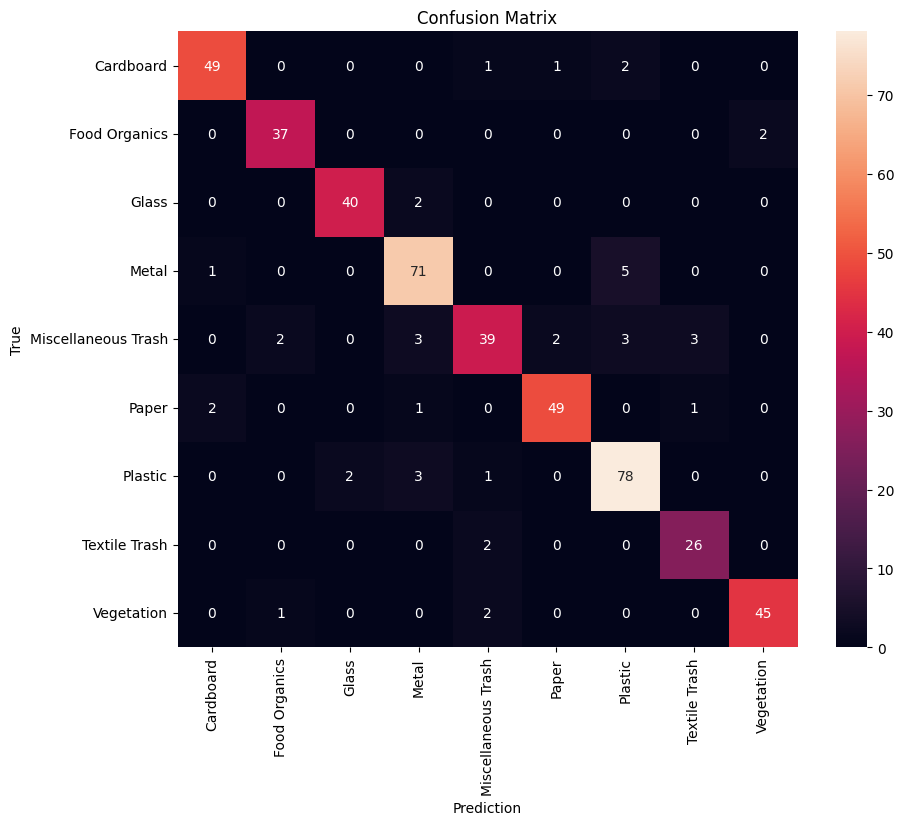

Test Ediliyor: efficientNet_finetuned_simam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.82      0.89      0.85        53
      Food Organics       0.85      0.90      0.88        39
              Glass       0.86      0.86      0.86        42
              Metal       0.82      0.88      0.85        77
Miscellaneous Trash       0.84      0.69      0.76        52
              Paper       0.89      0.75      0.82        53
            Plastic       0.85      0.82      0.84        84
      Textile Trash       0.75      0.86      0.80        28
         Vegetation       0.90      0.98      0.94        48

           accuracy                           0.84       476
          macro avg       0.84      0.85      0.84       476
       weighted avg       0.85      0.84      0.84       476



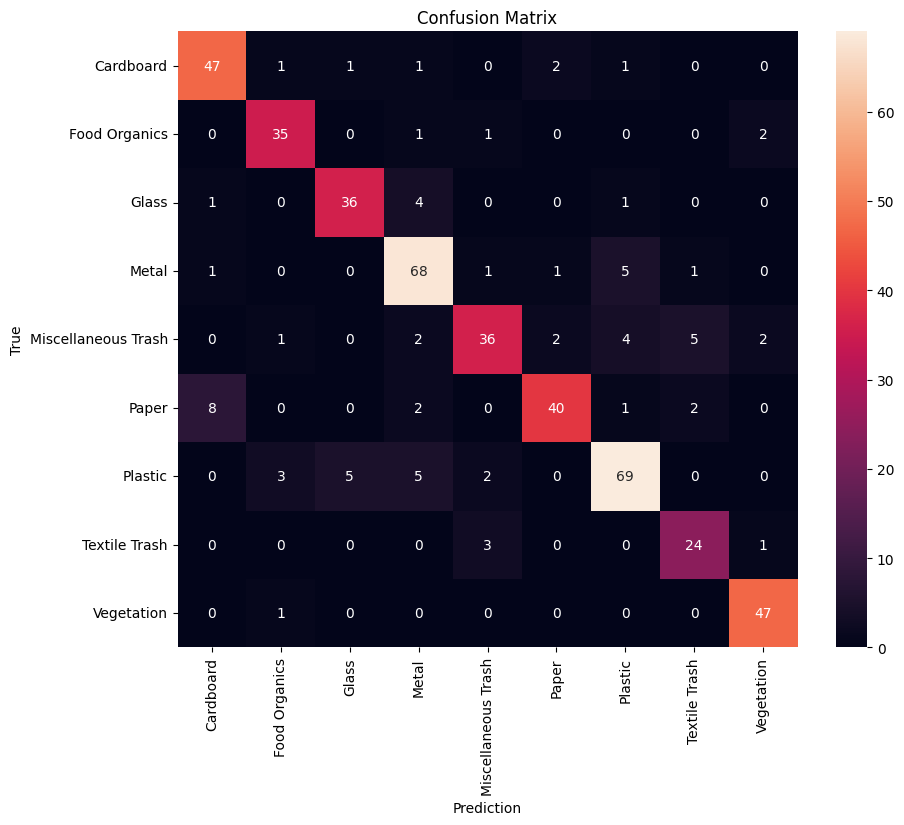

Test Ediliyor: resnet18_finetuned_ca
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.96      0.98      0.97        53
      Food Organics       0.94      0.87      0.91        39
              Glass       0.85      0.95      0.90        42
              Metal       0.86      0.92      0.89        77
Miscellaneous Trash       0.90      0.83      0.86        52
              Paper       0.96      0.89      0.92        53
            Plastic       0.93      0.89      0.91        84
      Textile Trash       0.93      0.89      0.91        28
         Vegetation       0.92      0.98      0.95        48

           accuracy                           0.91       476
          macro avg       0.92      0.91      0.91       476
       weighted avg       0.91      0.91      0.91       476



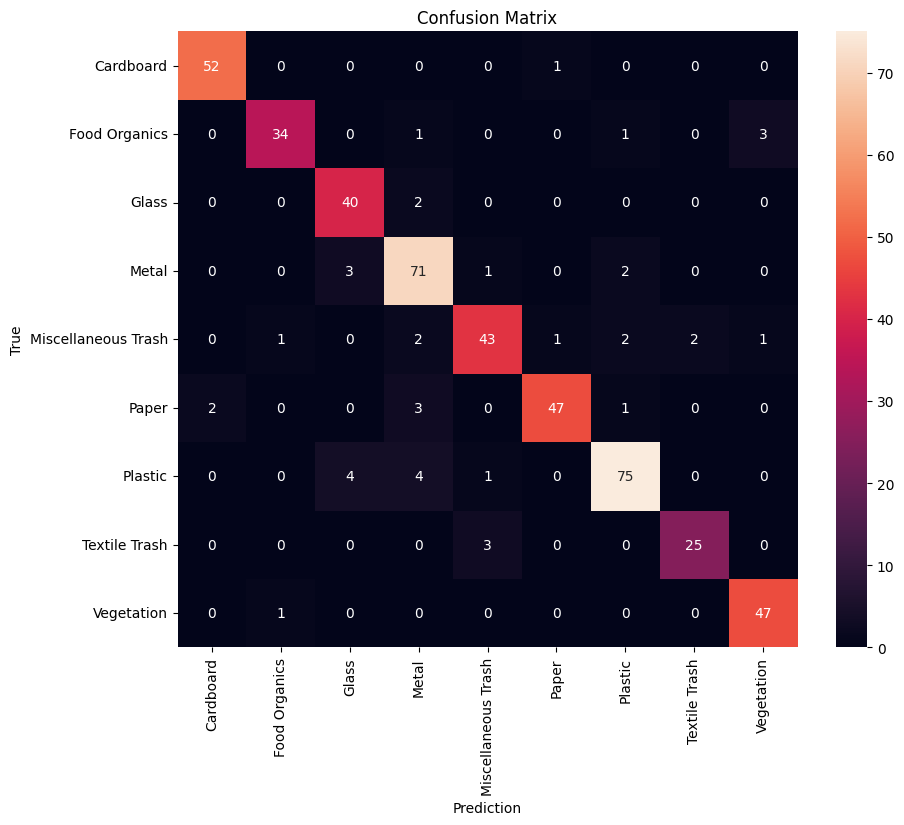

Test Ediliyor: resnet18_finetuned_se_ca
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.94      0.96      0.95        53
      Food Organics       0.95      0.90      0.92        39
              Glass       0.89      0.98      0.93        42
              Metal       0.95      0.90      0.92        77
Miscellaneous Trash       0.88      0.81      0.84        52
              Paper       0.91      0.94      0.93        53
            Plastic       0.93      0.93      0.93        84
      Textile Trash       0.96      0.93      0.95        28
         Vegetation       0.90      0.98      0.94        48

           accuracy                           0.92       476
          macro avg       0.92      0.92      0.92       476
       weighted avg       0.92      0.92      0.92       476



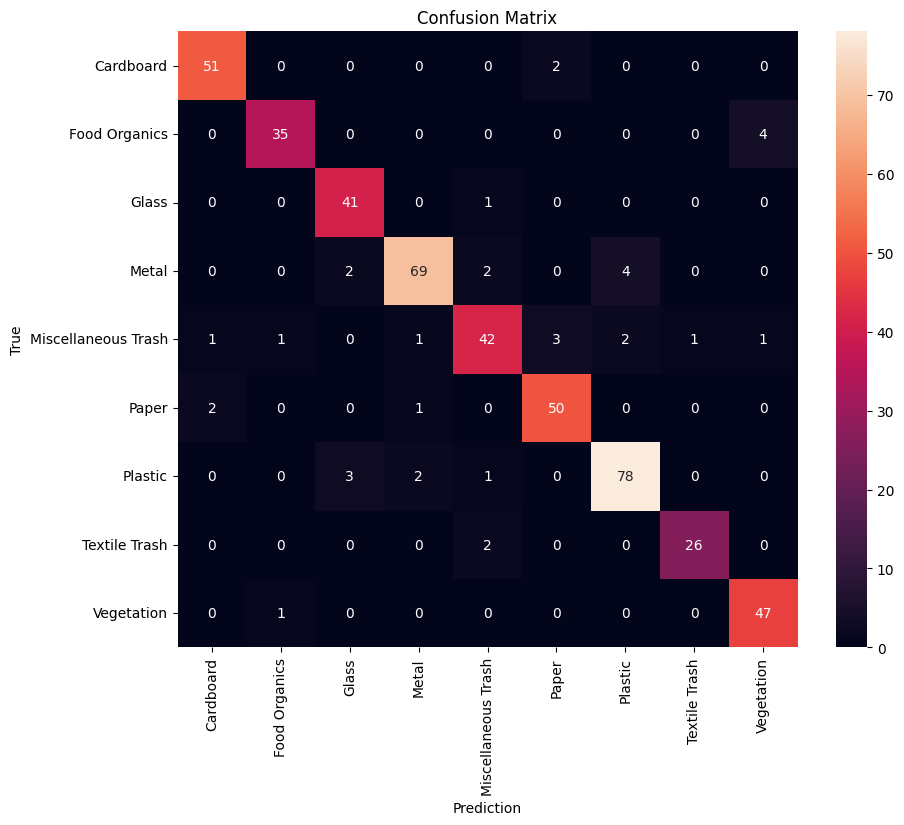

Test Ediliyor: efficientNet_finetuned_ca
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.94      0.92      0.93        53
      Food Organics       0.90      0.92      0.91        39
              Glass       0.87      0.98      0.92        42
              Metal       0.95      0.95      0.95        77
Miscellaneous Trash       0.94      0.87      0.90        52
              Paper       0.92      0.89      0.90        53
            Plastic       0.93      0.90      0.92        84
      Textile Trash       0.90      0.93      0.91        28
         Vegetation       0.94      0.98      0.96        48

           accuracy                           0.92       476
          macro avg       0.92      0.93      0.92       476
       weighted avg       0.93      0.92      0.92       476



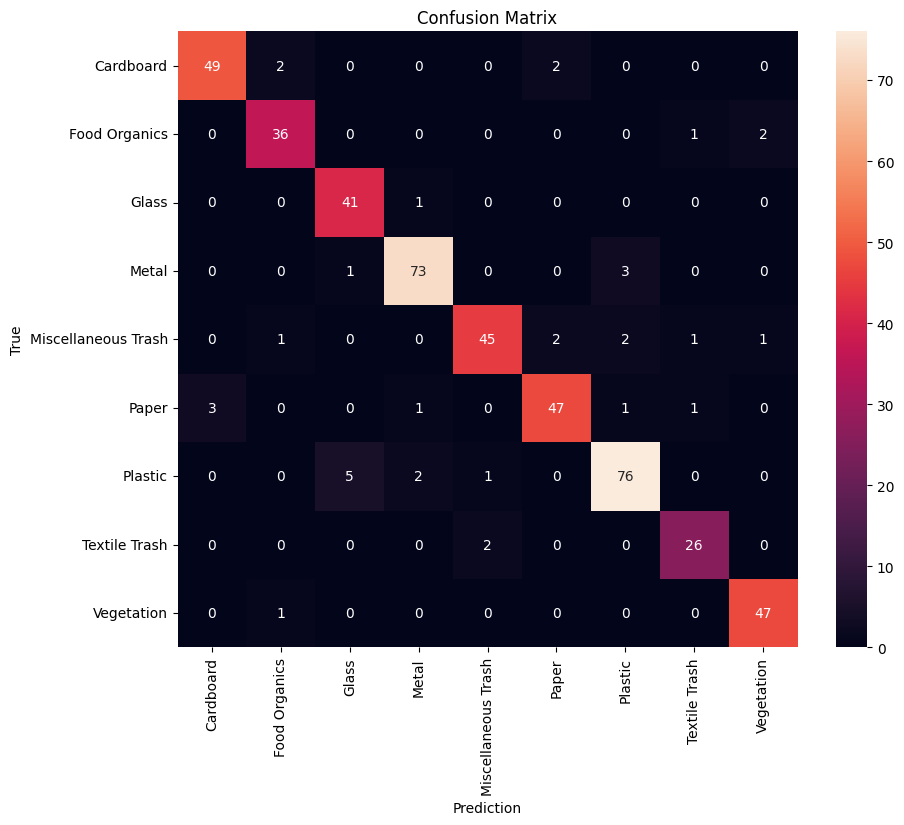

Test Ediliyor: efficientNet_finetuned_se_ca
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.94      0.96      0.95        53
      Food Organics       0.97      1.00      0.99        39
              Glass       0.87      0.98      0.92        42
              Metal       0.99      0.95      0.97        77
Miscellaneous Trash       0.94      0.88      0.91        52
              Paper       0.94      0.94      0.94        53
            Plastic       0.93      0.89      0.91        84
      Textile Trash       0.90      0.96      0.93        28
         Vegetation       0.98      0.98      0.98        48

           accuracy                           0.94       476
          macro avg       0.94      0.95      0.94       476
       weighted avg       0.94      0.94      0.94       476



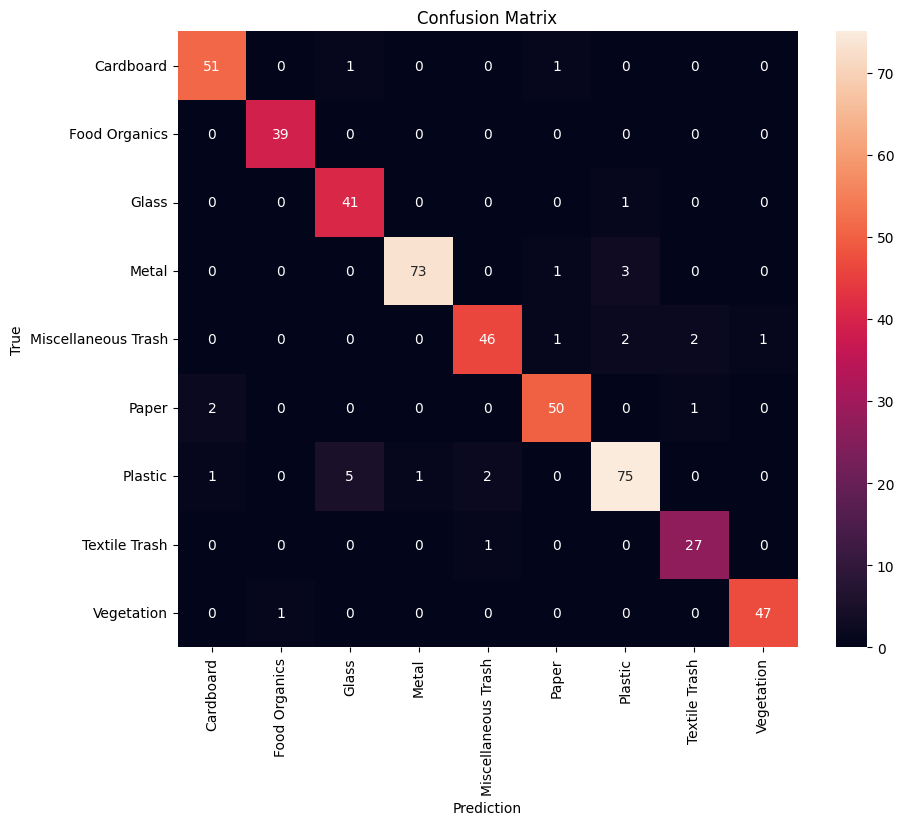

Test Ediliyor: efficientnet_dcn
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.91      0.92      0.92        53
      Food Organics       0.93      0.95      0.94        39
              Glass       0.97      0.93      0.95        42
              Metal       0.92      0.88      0.90        77
Miscellaneous Trash       0.85      0.75      0.80        52
              Paper       0.92      0.89      0.90        53
            Plastic       0.86      0.93      0.89        84
      Textile Trash       0.86      0.89      0.88        28
         Vegetation       0.92      0.98      0.95        48

           accuracy                           0.90       476
          macro avg       0.90      0.90      0.90       476
       weighted avg       0.90      0.90      0.90       476



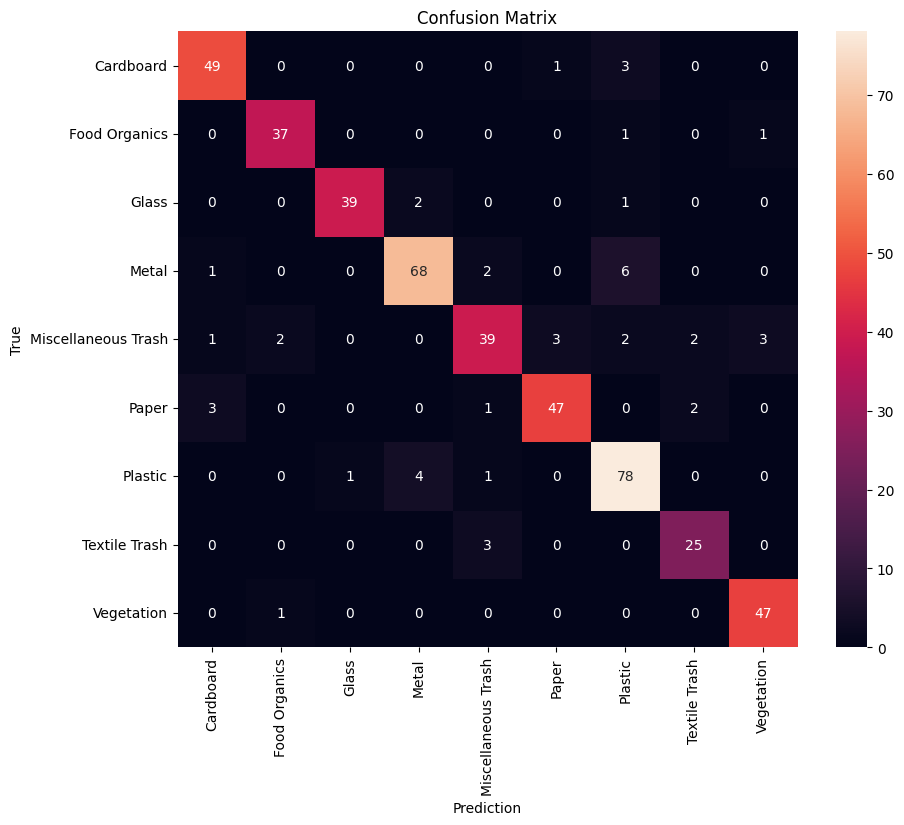

Test Ediliyor: efficientNet_dcn_finetuned
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.96      0.98      0.97        53
      Food Organics       0.97      0.97      0.97        39
              Glass       0.91      0.98      0.94        42
              Metal       0.94      0.95      0.94        77
Miscellaneous Trash       0.92      0.88      0.90        52
              Paper       0.96      0.91      0.93        53
            Plastic       0.93      0.92      0.92        84
      Textile Trash       0.93      0.93      0.93        28
         Vegetation       0.96      0.98      0.97        48

           accuracy                           0.94       476
          macro avg       0.94      0.94      0.94       476
       weighted avg       0.94      0.94      0.94       476



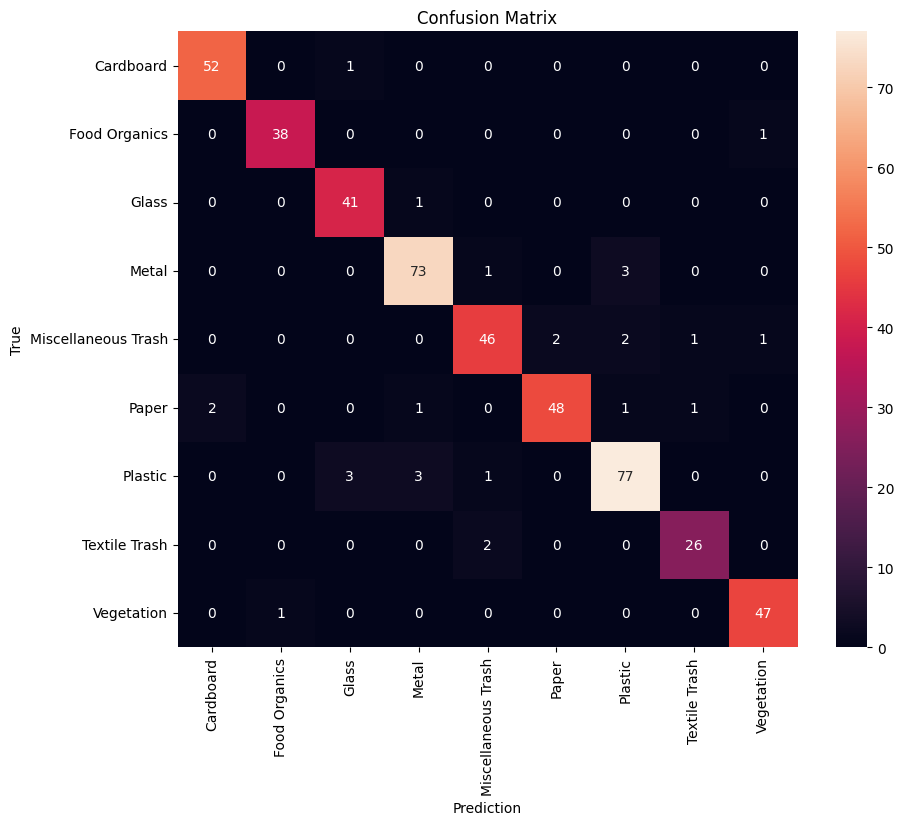

Test Ediliyor: efficientnet_dcn_cbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.95      0.79      0.87        53
      Food Organics       0.95      0.90      0.92        39
              Glass       0.85      0.98      0.91        42
              Metal       0.94      0.81      0.87        77
Miscellaneous Trash       0.80      0.77      0.78        52
              Paper       0.87      0.91      0.89        53
            Plastic       0.75      0.92      0.82        84
      Textile Trash       0.92      0.79      0.85        28
         Vegetation       0.94      0.96      0.95        48

           accuracy                           0.87       476
          macro avg       0.89      0.87      0.87       476
       weighted avg       0.88      0.87      0.87       476



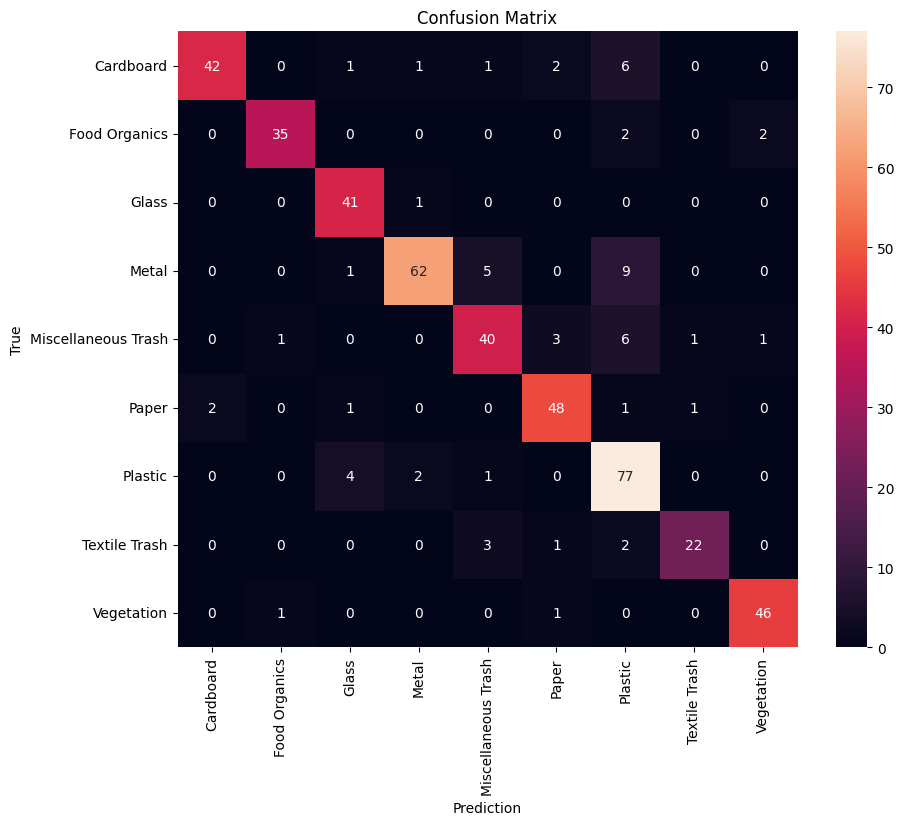

Test Ediliyor: efficientNet_dcn_finetuned_cbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.91      0.94      0.93        53
      Food Organics       0.97      0.97      0.97        39
              Glass       0.95      0.95      0.95        42
              Metal       0.96      0.94      0.95        77
Miscellaneous Trash       0.90      0.87      0.88        52
              Paper       0.96      0.92      0.94        53
            Plastic       0.90      0.95      0.92        84
      Textile Trash       1.00      0.93      0.96        28
         Vegetation       0.96      0.98      0.97        48

           accuracy                           0.94       476
          macro avg       0.95      0.94      0.94       476
       weighted avg       0.94      0.94      0.94       476



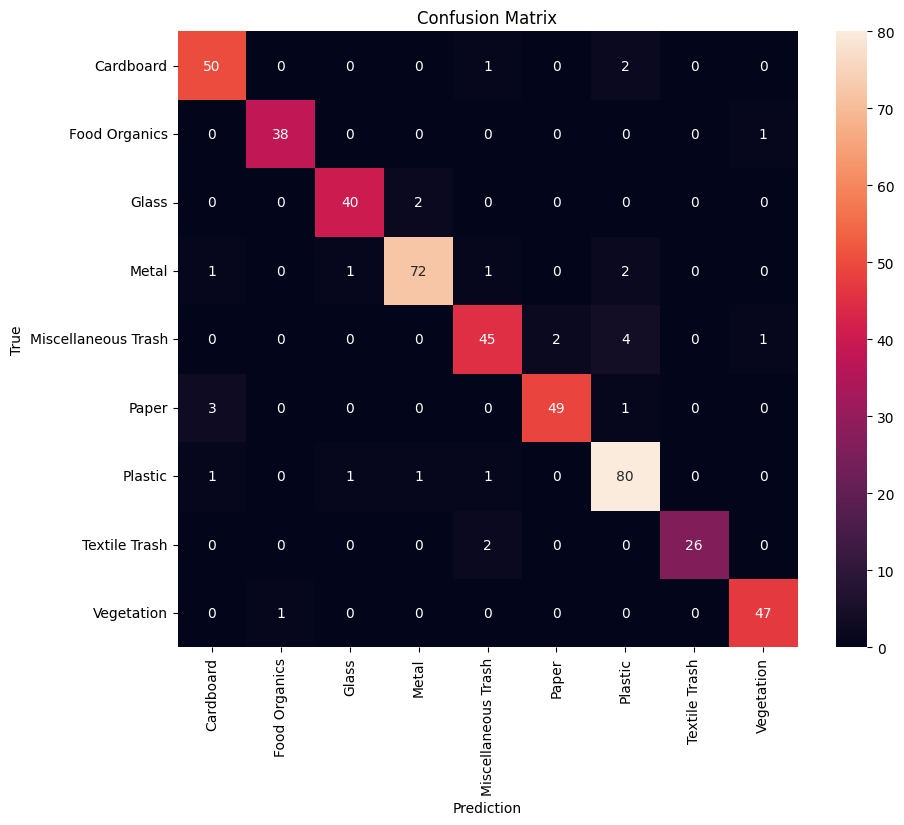

Test Ediliyor: resnet_dcn
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.87      0.64      0.74        53
      Food Organics       0.67      0.85      0.75        39
              Glass       0.80      0.79      0.80        42
              Metal       0.78      0.83      0.81        77
Miscellaneous Trash       0.55      0.69      0.62        52
              Paper       0.77      0.81      0.79        53
            Plastic       0.84      0.67      0.74        84
      Textile Trash       0.72      0.46      0.57        28
         Vegetation       0.78      0.96      0.86        48

           accuracy                           0.75       476
          macro avg       0.75      0.74      0.74       476
       weighted avg       0.76      0.75      0.75       476



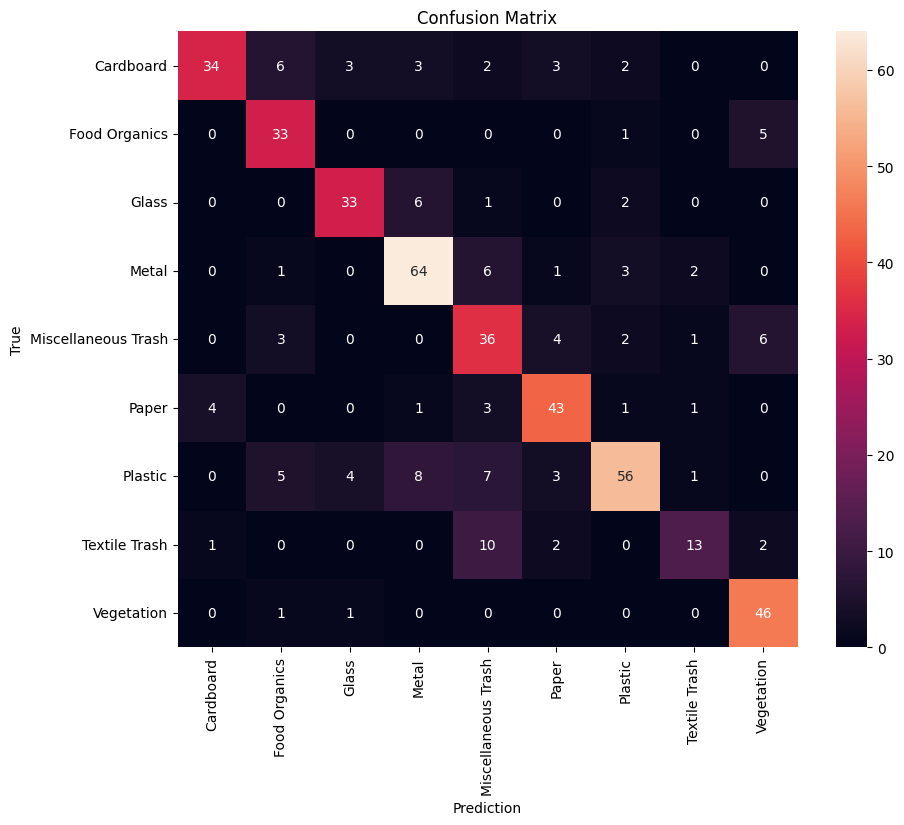

Test Ediliyor: resnet_dcn_finetuned
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.90      0.87      0.88        53
      Food Organics       0.88      0.90      0.89        39
              Glass       0.93      0.90      0.92        42
              Metal       0.92      0.87      0.89        77
Miscellaneous Trash       0.84      0.83      0.83        52
              Paper       0.96      0.87      0.91        53
            Plastic       0.86      0.93      0.89        84
      Textile Trash       0.86      0.86      0.86        28
         Vegetation       0.89      0.98      0.93        48

           accuracy                           0.89       476
          macro avg       0.89      0.89      0.89       476
       weighted avg       0.89      0.89      0.89       476



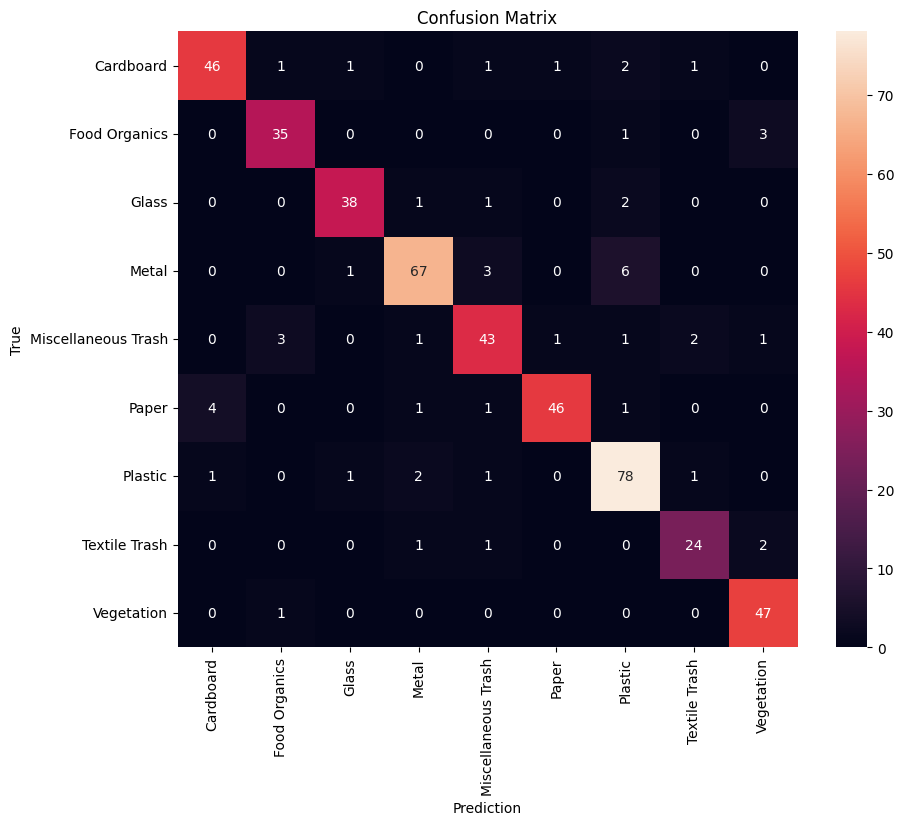

Test Ediliyor: resnet_dcn_cbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.91      0.58      0.71        53
      Food Organics       0.72      1.00      0.84        39
              Glass       0.90      0.88      0.89        42
              Metal       0.82      0.77      0.79        77
Miscellaneous Trash       0.85      0.44      0.58        52
              Paper       0.79      0.94      0.86        53
            Plastic       0.74      0.85      0.79        84
      Textile Trash       0.59      0.82      0.69        28
         Vegetation       0.92      0.96      0.94        48

           accuracy                           0.80       476
          macro avg       0.81      0.80      0.79       476
       weighted avg       0.81      0.80      0.79       476



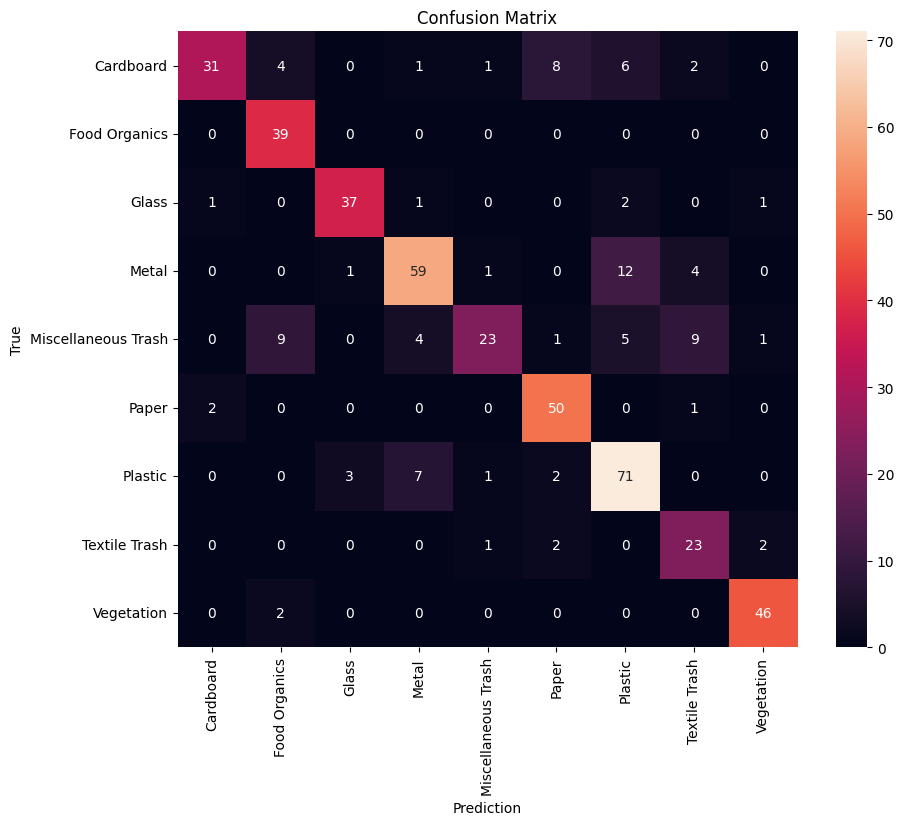

Test Ediliyor: resnet_dcn_cbam_finetuned_cbam
------------------
F1 Skoru 
------------------
                     precision    recall  f1-score   support

          Cardboard       0.87      0.91      0.89        53
      Food Organics       0.86      0.95      0.90        39
              Glass       0.91      0.93      0.92        42
              Metal       0.89      0.96      0.93        77
Miscellaneous Trash       0.85      0.67      0.75        52
              Paper       0.86      0.91      0.88        53
            Plastic       0.95      0.85      0.89        84
      Textile Trash       0.83      0.89      0.86        28
         Vegetation       0.94      0.98      0.96        48

           accuracy                           0.89       476
          macro avg       0.88      0.89      0.89       476
       weighted avg       0.89      0.89      0.89       476



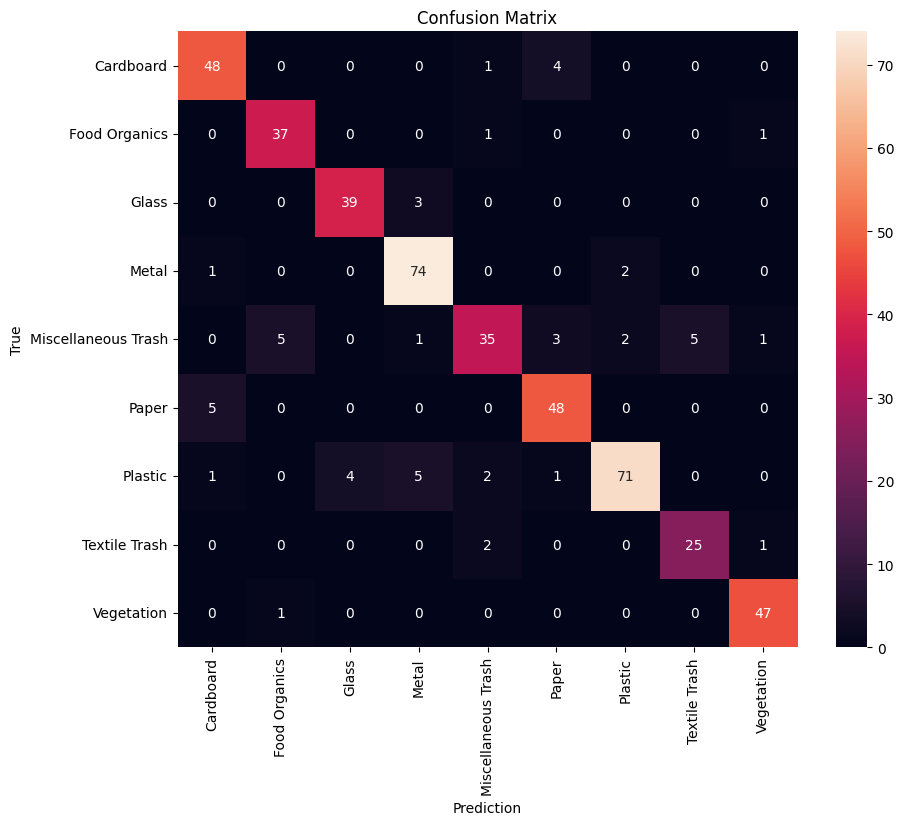


--- Model Karşılaştırma Tablosu ---


,Model,Best Acc (%),Final Acc (%),Best Loss,Final Loss
0,efficientNet_dcn_finetuned,95.58,94.53,0.6188,0.6240
1,efficientNet_finetuned_secbam,94.95,94.32,0.6329,0.6447
2,efficientNet_finetuned_se_ca,94.95,93.68,0.6147,0.6360
3,efficientNet_finetuned_cbam,93.68,93.05,0.6463,0.6602
4,efficientNet_dcn_finetuned_cbam,93.68,93.68,0.6532,0.6532
5,efficientNet_finetuned,93.47,92.84,0.6576,0.6602
6,resnet18_finetuned_cbam,92.63,92.42,0.6708,0.6708
7,efficientNet_finetuned_ca,92.21,90.95,0.6774,0.6932
8,mobileNet2_finetuned,92.00,91.58,0.6978,0.6991
9,resnet18_finetuned_secbam,91.79,90.74,0.6846,0.6846


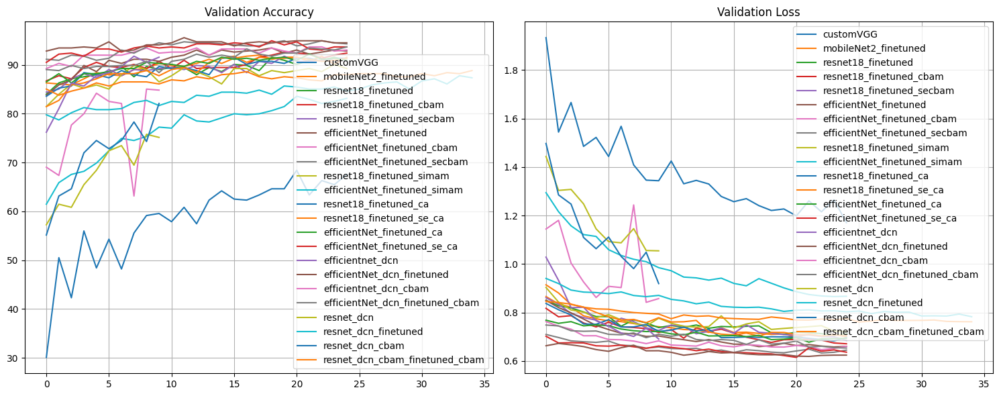

Seçilen resim: /content/dataset_root/realwaste-main/RealWaste/Metal/Metal_171.jpg


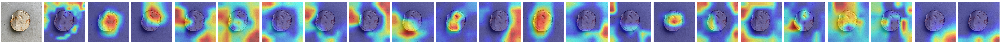


--- Modeller Kaydediliyor ---
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/customVGG.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/mobileNet2_finetuned.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/resnet18_finetuned.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/resnet18_finetuned_cbam.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/resnet18_finetuned_secbam.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/efficientNet_finetuned.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/efficientNet_finetuned_cbam.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/efficientNet_finetuned_secbam.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/resnet18_finetuned_simam.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/efficientNet_finetuned_simam.pth
Kaydedildi: /content/drive/MyDrive/DeepLearningProje/Modeller2/r

In [ ]:
run_all_tests(my_models, loader_test, device, full_dataset.classes)

plot_performance_results(global_loss_accuracy, exclude_filter="fc")

test_img = find_test_image(extract_path)
compare_gradcams(my_models, test_img, device)

save_dir = '/content/drive/MyDrive/DeepLearningProje/Modeller2/'
save_all_models(my_models, save_dir)

## **Örnek Bölümü**

In [ ]:
def load_saved_models(model_dir, file_list, num_classes, device):
    loaded_models = {}
    print(f"{'='*10} Modeller Yükleniyor (Basit Mod) {'='*10}")

    for f_name in file_list:
        path = os.path.join(model_dir, f_name)
        if not os.path.exists(path):
            continue

        try:
            model = None
            name = f_name.lower()
            if "efficientnet_dcn_finetuned.pth" in name:
                print(f"ÖZEL MODEL: {f_name} (DCN + SE_CA yüklendi)")
                model = efficientnet_upgraded_func(num_classes, SE_toCA=True)


            elif "efficientnet_dcn_finetuned_cbam" in name:
                model = efficientnet_upgraded_func(num_classes, cbam=True)


            elif "resnet_dcn_finetuned.pth" in name:
                print(f"ÖZEL MODEL: {f_name} (DCN Layer=2 + SE_CA yüklendi)")
                model = resnet18_with_dcn(num_classes, dcn_layers=2, SE_toCA=True)

            elif "resnet_dcn" in name and "cbam" in name:
                model = resnet18_with_dcn(num_classes, dcn_layers=2, cbam=True)


            elif "mobilenet" in name:
                model = mobilenet_v2_finetune(mobilenet_v2_fc(num_classes))

            elif "efficientnet" in name:
                is_cbam = "cbam" in name and "secbam" not in name
                is_secbam = "secbam" in name
                is_seca = "se_ca" in name
                is_ca = "_ca" in name and not is_seca
                is_simam = "simam" in name

                model = efficientnet_b0_fc(num_classes, cbam=is_cbam, simam=is_simam, ca=is_ca, SE_toCBAM=is_secbam, SE_toCA=is_seca)

            elif "resnet" in name:
                is_cbam = "cbam" in name and "secbam" not in name
                is_secbam = "secbam" in name
                is_seca = "se_ca" in name
                is_ca = "_ca" in name and not is_seca
                is_simam = "simam" in name

                model = resnet_fc(num_classes, cbam=is_cbam, simam=is_simam, ca=is_ca, SE_toCBAM=is_secbam, SE_toCA=is_seca)

            if model is not None:
                model.load_state_dict(torch.load(path, map_location=device), strict=False)
                model.to(device).eval()

                clean_name = f_name.replace(".pth", "").replace("finetuned_", "")
                loaded_models[clean_name] = model

        except Exception as e:
            print(f"HATA: {f_name} -> {e}")

    return loaded_models

========== Modeller Yükleniyor (Basit Mod) ==========
size  1280
Position= features.1.0.block.1, Input Channel= 32
Index= 1
Parent= features.1.0.block
Position= features.2.0.block.2, Input Channel= 96
Index= 2
Parent= features.2.0.block
Position= features.2.1.block.2, Input Channel= 144
Index= 2
Parent= features.2.1.block
Position= features.3.0.block.2, Input Channel= 144
Index= 2
Parent= features.3.0.block
Position= features.3.1.block.2, Input Channel= 240
Index= 2
Parent= features.3.1.block
Position= features.4.0.block.2, Input Channel= 240
Index= 2
Parent= features.4.0.block
Position= features.4.1.block.2, Input Channel= 480
Index= 2
Parent= features.4.1.block
Position= features.4.2.block.2, Input Channel= 480
Index= 2
Parent= features.4.2.block
Position= features.5.0.block.2, Input Channel= 480
Index= 2
Parent= features.5.0.block
Position= features.5.1.block.2, Input Channel= 672
Index= 2
Parent= features.5.1.block
Position= features.5.2.block.2, Input Channel= 672
Index= 2
Parent=

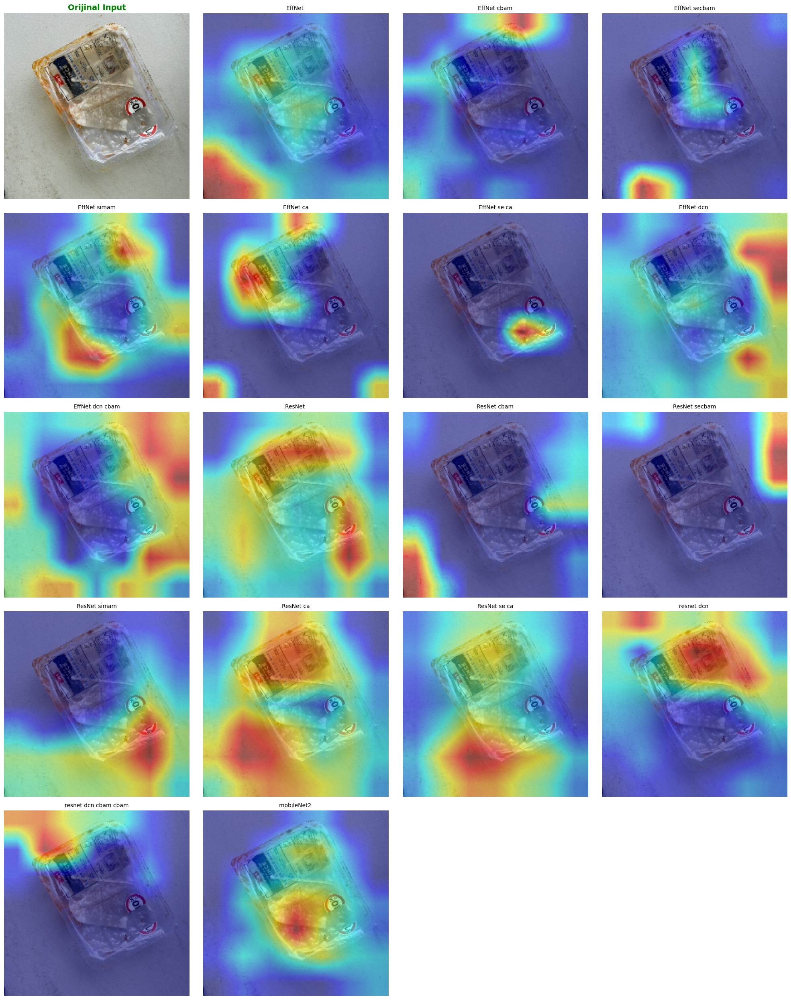

In [ ]:
MODEL_DIR = '/content/drive/MyDrive/DeepLearningProje/Modeller2'

target_models = [
    # 1. EfficientNet Ailesi
    "efficientNet_finetuned.pth",
    "efficientNet_finetuned_cbam.pth",
    "efficientNet_finetuned_secbam.pth",
    "efficientNet_finetuned_simam.pth",
    "efficientNet_finetuned_ca.pth",
    "efficientNet_finetuned_se_ca.pth",
    "efficientNet_dcn_finetuned.pth",
    "efficientNet_dcn_finetuned_cbam.pth",

    # 2. ResNet Ailesi
    "resnet18_finetuned.pth",
    "resnet18_finetuned_cbam.pth",
    "resnet18_finetuned_secbam.pth",
    "resnet18_finetuned_simam.pth",
    "resnet18_finetuned_ca.pth",
    "resnet18_finetuned_se_ca.pth",
    "resnet_dcn_finetuned.pth",
    "resnet_dcn_cbam_finetuned_cbam.pth",

    # 3. MobileNet (Baseline)
    "mobileNet2_finetuned.pth"
]


my_finetuned_models = load_saved_models(MODEL_DIR, target_models, NUM_CLASSES, device)

test_img = find_test_image(extract_path)
compare_gradcams_final(my_finetuned_models, test_img, device)


Seçilen resim: /content/dataset_root/realwaste-main/RealWaste/Paper/Paper_122.jpg


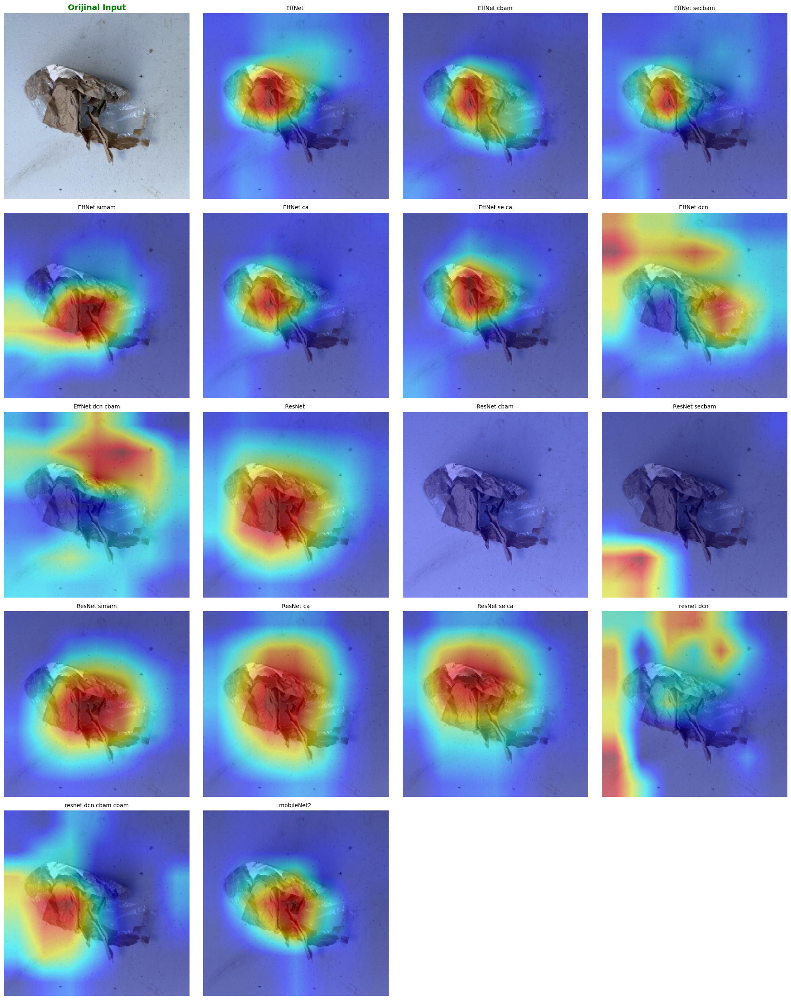

In [ ]:

test_img = find_test_image(extract_path)

try:
    compare_gradcams_final(my_finetuned_models, test_img, device)
    plt.show()
except Exception as e:
    print(f"Çizim sırasında hata oluştu: {e}")